# 1.    Project Overview #

### 1.1. Project Title: ###
## Analyzing Business Closures in San Francisco, CA: A Machine Learning Approach ##

**Project Goal:**

The primary goal of this data science analysis is to provide valuable insights into factors affecting business closures in San Francisco and, based on historical data, predict which businesses are more likely to close in the near future. The analysis focuses on utilizing machine learning techniques to make these predictions, taking into account a wide range of features, including business type, location, tax payment history, and economic indicators. Additionally, the project aims to provide location-based insights by identifying thriving and struggling business areas in San Francisco, which can be beneficial for entrepreneurs and policymakers. This analysis is especially relevant in the context of assessing the impacts of crime on businesses.

**Executive Summary:**

This data science project centers on the analysis and prediction of business closures in San Francisco, California. Understanding the dynamics behind business closures is crucial for both the local business community and city policymakers. By leveraging historical data, we aim to shed light on the factors influencing closures and, subsequently, develop predictive models to anticipate future closures. The analysis considers a wide array of features, such as business type, location, tax payment history, and economic indicators, to capture the multifaceted nature of this problem.

One of the core objectives is to develop a machine learning model, primarily utilizing XGBoost, to make predictions about which businesses are at a higher risk of closure. Addressing the issue of class imbalance is paramount in this context, and we employ the Synthetic Minority Over-sampling Technique (SMOTE) to create a balanced training dataset.

The project delves into location-based insights by employing clustering algorithms to categorize businesses into clusters based on similar characteristics. This approach enables us to identify areas in San Francisco where businesses are thriving and areas where they face challenges. The results of this analysis can serve as a valuable resource for entrepreneurs, policymakers, and stakeholders who aim to make data-informed decisions for the city's economic development.

As part of our model evaluation, we assess the model's performance using F1 score, ROC AUC, and the classification report, providing comprehensive insights into its predictive capabilities. The results indicate that the model can effectively identify businesses at risk of closure, contributing to the potential for proactive interventions.

Although this project was meant initially to be my data science personal endeavor, I hope it can also be a means of providing actionable insights for the benefit of San Francisco's business community and its economic vitality. By bridging the gap between data analytics and real-world applications, this analysis seeks to empower stakeholders and decision-makers in their efforts to ensure a thriving business environment in the city.

**Data Sources:**

- **City of San Francisco Business Data (CSV):**

  - CSV URL: [City of San Francisco Business Data](https://data.sfgov.org/api/views/g8m3-pdis/rows.csv?accessType=DOWNLOAD&bom=true&format=true)

  - This dataset contains information about registered businesses in San Francisco, including details such as business start and end dates, NAICS code descriptions, and geographical coordinates.

- **Bay Area Rapid Transport Data (Excel):**

  - Excel URL: [Bay Area Rapid Transport Data](http://64.111.127.166/DSE/Daily_Station_Exits.xlsx)

  - This dataset provides information on daily station exits for the Bay Area Rapid Transit (BART) system, which is a key aspect of transportation and commute in San Francisco.

- **San Francisco Police Department Data (CSV):**

  - CSV URL: [San Francisco Police Department Data](https://data.sfgov.org/api/views/wg3w-h783/rows.csv?accessType=DOWNLOAD&bom=true&format=true)

  - This dataset contains information about crime incidents in San Francisco, which could be a potential factor influencing business closures.


# 2.    Import Neccessary Libraries #

In [96]:
import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go

import geopandas as gpd
from shapely.geometry import Point
import re

from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import StandardScaler

from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import chi2, mutual_info_classif

from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
from xgboost import XGBClassifier 
from sklearn.metrics import roc_auc_score, f1_score, roc_curve, auc, accuracy_score, precision_score, recall_score

from sklearn.model_selection import RandomizedSearchCV
from imblearn.over_sampling import SMOTE

from sklearn.model_selection import GridSearchCV

from xgboost import XGBClassifier
from sklearn.linear_model import LogisticRegression

import xgboost as xgb

from imblearn.under_sampling import RandomUnderSampler

from sklearn.metrics import classification_report



%matplotlib inline

pd.set_option('display.max_columns', None)




# 3.    Data Collection and Loading #

### Datasets ###

This code fetches data from the provided URLs, creates Pandas DataFrames for each dataset, and then saves these DataFrames as separate CSV files for further analysis or storage.

In [88]:
# #importing datasets for a data analysis project.

# # URLs of the CSV and Excel files
# csv_url = "https://data.sfgov.org/api/views/g8m3-pdis/rows.csv?accessType=DOWNLOAD&bom=true&format=true"
# excel_url = "http://64.111.127.166/DSE/Daily_Station_Exits.xlsx"
# second_csv_url = "https://data.sfgov.org/api/views/wg3w-h783/rows.csv?accessType=DOWNLOAD&bom=true&format=true"

# # Download and create DataFrames
# df_raw = pd.read_csv(csv_url)  #Business data
# df_raw2 = pd.read_excel(excel_url) #BART Daily station exits
# df_pol2 = pd.read_csv(second_csv_url) #San Francisco Police crime incident reports 2018 to present




/var/folders/2x/6pwz1dgs2z3_zd5ztxz6lsv80000gn/T/ipykernel_7206/361660618.py:9: DtypeWarning:

Columns (14,20) have mixed types. Specify dtype option on import or set low_memory=False.



This code below fetches data from the provided URLs, creates Pandas DataFrames for each dataset, and then saves these DataFrames as separate CSV files for further analysis or storage.

In [98]:


# URLs of the CSV and Excel files
csv_url = "https://data.sfgov.org/api/views/g8m3-pdis/rows.csv?accessType=DOWNLOAD&bom=true&format=true"
excel_url = "http://64.111.127.166/DSE/Daily_Station_Exits.xlsx"
second_csv_url = "https://data.sfgov.org/api/views/wg3w-h783/rows.csv?accessType=DOWNLOAD&bom=true&format=true"

# Download and create DataFrames
df_raw = pd.read_csv(csv_url)  # Business data
df_raw2 = pd.read_excel(excel_url)  # BART Daily station exits
df_pol2 = pd.read_csv(second_csv_url)  # San Francisco Police crime incident reports 2018 to present

# Save DataFrames to CSV files
df_raw.to_csv("business_data.csv", index=False)
df_raw2.to_csv("bart_daily_station_exits.csv", index=False)
df_pol2.to_csv("sf_police_crime_reports.csv", index=False)


/var/folders/2x/6pwz1dgs2z3_zd5ztxz6lsv80000gn/T/ipykernel_7206/3455316478.py:7: DtypeWarning:

Columns (14) have mixed types. Specify dtype option on import or set low_memory=False.



Below, we read CSV files into Pandas DataFrames for three different datasets (business data, BART daily station exits, and police crime reports). we then clean up the df_trv DataFrame by selecting specific columns, potentially preparing it for further analysis.

In [99]:

# Read the CSV files into DataFrames
df_sf = pd.read_csv('/Users/baboo/Desktop/SF/business_data.csv')
df_trv = pd.read_csv('/Users/baboo/Desktop/SF/bart_daily_station_exits.csv')
df_pol3 = pd.read_csv('/Users/baboo/Desktop/SF/sf_police_crime_reports.csv')

# Clean up df_trv by selecting specific columns
df_trv = df_trv[['FY','Qtr','Month','Day','Date','EM', 'MT', 'PL', 'CC', '16', '24', 'GP', 'BP']]


/var/folders/2x/6pwz1dgs2z3_zd5ztxz6lsv80000gn/T/ipykernel_7206/3980663929.py:2: DtypeWarning:

Columns (14) have mixed types. Specify dtype option on import or set low_memory=False.



# 4. Data Exploration & Preprocessing #

### 4.1 San Francisco Business Data ###

We then retrieve the data types of each column in our DataFrame df_sf.

In [100]:
df_sf.dtypes

Location Id                             object
Business Account Number                  int64
Ownership Name                          object
DBA Name                                object
Street Address                          object
City                                    object
State                                   object
Source Zipcode                          object
Business Start Date                     object
Business End Date                       object
Location Start Date                     object
Location End Date                       object
Mail Address                            object
Mail City                               object
Mail Zipcode                            object
Mail State                              object
NAICS Code                              object
NAICS Code Description                  object
Parking Tax                               bool
Transient Occupancy Tax                   bool
LIC Code                                object
LIC Code Desc

We then generate a statistical summary of our DataFrame. This summary provides various statistical measures for each numerical column in the DataFrame. 

In [4]:
df_sf.describe()

,Business Account Number,Supervisor District,SF Find Neighborhoods,Current Police Districts,Current Supervisor Districts,Analysis Neighborhoods,Neighborhoods
count,3.151140e+05,257111.000000,257112.000000,255865.000000,257117.000000,257099.000000,257112.000000
mean,7.339440e+05,5.564966,57.451920,5.258019,6.251590,18.874846,57.451920
std,3.585857e+05,2.886056,35.091398,2.871059,3.202783,12.204737,35.091398
min,2.400000e+01,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
25%,4.202732e+05,3.000000,31.000000,3.000000,3.000000,8.000000,31.000000
50%,9.343330e+05,6.000000,53.000000,6.000000,6.000000,20.000000,53.000000
75%,1.081273e+06,8.000000,95.000000,8.000000,10.000000,30.000000,95.000000
max,1.151534e+06,11.000000,117.000000,10.000000,11.000000,41.000000,117.000000


We retrieve and display the column labels (column names) of our DataFrame

In [5]:
df_sf.columns

Index(['Location Id', 'Business Account Number', 'Ownership Name', 'DBA Name',
       'Street Address', 'City', 'State', 'Source Zipcode',
       'Business Start Date', 'Business End Date', 'Location Start Date',
       'Location End Date', 'Mail Address', 'Mail City', 'Mail Zipcode',
       'Mail State', 'NAICS Code', 'NAICS Code Description', 'Parking Tax',
       'Transient Occupancy Tax', 'LIC Code', 'LIC Code Description',
       'Supervisor District', 'Neighborhoods - Analysis Boundaries',
       'Business Corridor', 'Business Location', 'UniqueID',
       'SF Find Neighborhoods', 'Current Police Districts',
       'Current Supervisor Districts', 'Analysis Neighborhoods',
       'Neighborhoods'],
      dtype='object')

Below, we reformat the date columns in the df_sf DataFrame. We first parse the dates, then change their format to 'mm-dd-yyyy', and finally parse them again to ensure they are in the correct datetime format.

In [101]:
# change date columns to date format

# 'Business Start Date' and 'Business End Date' are in the format 'mm/dd/yyyy'
df_sf['Business Start Date'] = pd.to_datetime(df_sf['Business Start Date'], format='%m/%d/%Y')
df_sf['Business End Date'] = pd.to_datetime(df_sf['Business End Date'], format='%m/%d/%Y')

# Change the format to 'm-d-Y'
df_sf['Business Start Date'] = df_sf['Business Start Date'].dt.strftime('%m-%d-%Y')
df_sf['Business End Date'] = df_sf['Business End Date'].dt.strftime('%m-%d-%Y')

df_sf['Business Start Date'] = pd.to_datetime(df_sf['Business Start Date'], format='%m-%d-%Y')
df_sf['Business End Date'] = pd.to_datetime(df_sf['Business End Date'], format='%m-%d-%Y')

#df_sf.head()


We then filter the df_sf DataFrame to retain only the records for businesses that started in the last five years (from September 1, 2018, onwards) 

In [102]:
#filter only last 5 years
df_sf = df_sf[df_sf['Business Start Date'] >= '2018-09-01']
df_sf.reset_index(drop=True, inplace=True)

We then calculate the lifespan of businesses, replacing missing values with 0, and then filter the DataFrame to include only businesses located in San Francisco.

In [103]:
#create new column for biz age

# Create a new column 'lifespan' by calculating the difference in years
df_sf['lifespan'] = (df_sf['Business End Date'] - df_sf['Business Start Date']).dt.days // 365

# Replace NaN values (no business end date) with 0 in the 'lifespan' column
df_sf['lifespan'] = df_sf['lifespan'].fillna(0).astype(int)



# filter out only San fran city
df_sf = df_sf[df_sf['City'] == 'San Francisco']


#df_sf.head()

We create a new 'open' column in the DataFrame, indicating whether a business is open ('Y') or closed ('N') based on the presence or absence of a 'Business End Date'.

In [104]:
# Create a new 'open' column based on conditions
df_sf['open'] = np.where(df_sf['Business End Date'].isnull(), 'Y', 'N')
#df_sf.head()


We create a bar plot to visualize the count of open and closed businesses using Seaborn 

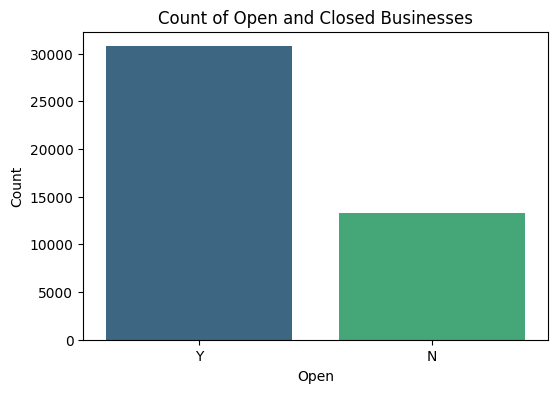

In [10]:
# Create a bar plot
plt.figure(figsize=(6, 4))
sns.countplot(data=df_sf, x='open', palette='viridis')
plt.title('Count of Open and Closed Businesses')
plt.xlabel('Open')
plt.ylabel('Count')
plt.show()

We calculate the ratio of open businesses to closed businesses, provide the total counts for each category.  We are trying to understand the distribution of open and closed businesses in the dataset.

In [105]:
# Calculate the count of 'Y' and 'N' in the 'open' column
open_count = df_sf['open'].value_counts()['Y']
closed_count = df_sf['open'].value_counts()['N']

# Calculate the ratio
ratio = open_count / closed_count

print(f"Ratio of open to closed businesses: {ratio:.2f}")
print(f"Total businesses open: {open_count}")
print(f"Total businesses closed: {closed_count}")

Ratio of open to closed businesses: 2.39
Total businesses open: 32641
Total businesses closed: 13643


We define a function to extract latitude and longitude from a specific format within a string, and then it applies this function to the DataFrame to create new columns with latitude and longitude values. It's a common technique for geospatial data preprocessing.

In [106]:
# Define a function to extract latitude and longitude
def extract_lat_lon(point_str):
    # Extract latitude and longitude using a regular expression
    match = re.search(r'\((-?\d+\.\d+) (-?\d+\.\d+)\)', point_str)
    if match:
        latitude = float(match.group(2))
        longitude = float(match.group(1))
        return latitude, longitude
    else:
        return None, None

# Apply the function to extract latitude and longitude
df_sf['latitude'], df_sf['longitude'] = zip(*df_sf['Business Location'].apply(extract_lat_lon))

# Print the DataFrame with the new 'latitude' and 'longitude' columns
#df_sf.head()

We perform date component extraction to break down the 'Business Start Date' into separate columns for the year, month, and quarter. 

In [107]:
# Extract year, month, and quarter and create new columns
df_sf['Year Opened'] = df_sf['Business Start Date'].dt.year
df_sf['Month Opened'] = df_sf['Business Start Date'].dt.month
df_sf['Quarter Opened'] = df_sf['Business Start Date'].dt.quarter


We transform the numeric representation of the day of the week into the actual day names and stores them in a new column in the DataFrame. 

In [108]:
df_sf['Day of Week Opened'] = df_sf['Business Start Date'].dt.dayofweek

# Convert the day of the week integer to the actual day name
day_names = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
df_sf['Day of Week Opened'] = df_sf['Day of Week Opened'].apply(lambda x: day_names[x])
#df_sf.head()

We perform date component extraction for the 'Business End Date' in the DataFrame, creating new columns to store the year, month, quarter, and day of the week for the end date. 

In [109]:

# Extract year, month, quarter, and day of the week for the end date
df_sf['Year Closed'] = df_sf['Business End Date'].dt.year
df_sf['Month Closed'] = df_sf['Business End Date'].dt.month
df_sf['Quarter Closed'] = df_sf['Business End Date'].dt.quarter
df_sf['Day of Week Closed'] = df_sf['Business End Date'].dt.dayofweek

# # Convert the day of the week integer to the actual day name, handling missing values
# day_names = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
# df_sf['Day of Week Closed'] = df_sf['Day of Week Closed'].apply(lambda x: day_names[x])

#df_sf.head()

Location Change Frequency:

Calculate how many times the business changed its location by counting the number of unique 'Location Id' entries for each 'Business Account Number'. Frequent location changes may indicate instability.

In [110]:
#Location Change Frequency

# Group the data by 'Business Account Number' and count unique 'Location Id' entries
location_change_frequency = df_sf.groupby('Business Account Number')['Location Id'].nunique()

# Create a new DataFrame to display the results
location_change_df = pd.DataFrame({
    'Business Account Number': location_change_frequency.index,
    'Location Change Frequency': location_change_frequency.values
})

# Merge the new DataFrame back into the original DataFrame
df_sf = pd.merge(df_sf, location_change_df, on='Business Account Number', how='left')


# Display the new DataFrame
#df_sf.head()

Ownership Change Frequency:

Calculate how many times the ownership changed by counting the number of unique 'Ownership Name' entries for each 'Business Account Number'. Frequent ownership changes could be a sign of business distress.

In [111]:
#####CHECK THIS CODE AGAIN - creates empty rows

# Group the data by 'Business Account Number' and count unique 'Ownership Name' entries
ownership_change_frequency = df_sf.groupby('Business Account Number')['Ownership Name'].nunique()

# Create a new DataFrame to display the results
ownership_change_df = pd.DataFrame({
    'Business Account Number': ownership_change_frequency.index,
    'Ownership Change Frequency': ownership_change_frequency.values
})

# Merge the new DataFrame back into the original DataFrame
df_sf = pd.merge(df_sf, ownership_change_df, on='Business Account Number', how='left')

# Display the modified DataFrame with the added column
#df_sf.head()


Check Business Type Change:

Determine if the business changed its primary NAICS code during its operation. This could indicate an attempt to adapt to market conditions or difficulties.

In [112]:
# Convert the 'NAICS Code' column to numeric (if it's not already)
df_sf['NAICS Code'] = pd.to_numeric(df_sf['NAICS Code'], errors='coerce')  # 'coerce' will handle non-numeric values as NaN

# Sort the DataFrame by 'Business Account Number' and 'Business Start Date'
df_sf.sort_values(by=['Business Account Number', 'Business Start Date'], inplace=True)

# Calculate Business Type Change by checking if NAICS code changes for each business
df_sf['Business Type Change'] = df_sf.groupby('Business Account Number')['NAICS Code'].diff().ne(0).astype(int)

# Display the modified DataFrame
#df_sf.head()

Location Turnover Rate:

Calculate the rate at which locations under the same 'Supervisor District' or 'Neighborhoods - Analysis Boundaries' have businesses closing. High turnover rates in specific areas may indicate issues with the local business environment.

Location Turnover Rate is a metric that helps you understand the frequency at which businesses within a specific geographic area, such as a Supervisor District or a Neighborhood, undergo changes or closures over a given period. It is an important indicator when analyzing the stability and economic dynamics of a particular region. Here's a more detailed explanation:

1. **Definition**: Location Turnover Rate is typically calculated by dividing the number of business closures in a specific area within a certain time frame by the total number of businesses operating in that same area during the same period. This rate is usually expressed as a percentage.

2. **Purpose**: Location Turnover Rate helps assess the economic health and business climate of a particular geographic region. It provides insights into how frequently businesses open and close within that area.

3. **Key Insights**:

   - **High Turnover Rate**: A high Location Turnover Rate suggests that businesses in the area frequently open and close. This could indicate a highly competitive or volatile business environment, where businesses struggle to thrive or adapt.

   - **Low Turnover Rate**: A low Location Turnover Rate implies a more stable business environment where businesses tend to remain open for longer periods. It may indicate a well-established and less competitive market.

4. **Factors Affecting Turnover Rate**:

   - **Economic Conditions**: Economic factors, such as recession, inflation, or unemployment rates, can influence the Location Turnover Rate. A weak economy may lead to higher closures.

   - **Market Saturation**: An oversaturated market with too many businesses offering similar services can lead to increased competition and higher turnover.

   - **Regulations**: Local regulations and policies can impact business closures. Easier licensing and regulatory processes may reduce closures.

   - **Consumer Behavior**: Changes in consumer preferences and buying habits can affect the demand for businesses in an area.
   
   - **Business Support**: Availability of resources, support programs, and business networks can impact business longevity.

5. **Use Cases**:

   - **Economic Analysis**: Economists and policymakers use Location Turnover Rate to assess the overall economic health of a region and make informed decisions.

   - **Business Planning**: Entrepreneurs and business owners may use this rate to identify areas with lower turnover rates as potential locations for their businesses.

   - **Real Estate**: Real estate investors consider turnover rates when evaluating the potential profitability of a location.

Location Turnover Rate is a crucial metric for assessing the business climate and economic dynamics of specific geographic areas. A high turnover rate may signal challenges in the local business environment, while a low turnover rate may indicate a more stable and favorable location for businesses.

In [113]:
#We perform data sorting and grouping to calculate the location turnover rate, which indicates how often businesses change locations within specific districts and neighborhoods. The results are merged back into the original DataFrame for further analysis and visualization.

# Sort the DataFrame by 'Supervisor District', 'Business Account Number', and 'Business Start Date'
df_sf.sort_values(by=['Supervisor District', 'Business Account Number', 'Business Start Date'], inplace=True)

# Calculate the number of unique 'Business Account Number' entries for each group of 'Supervisor District' or 'Neighborhoods - Analysis Boundaries'
location_counts = df_sf.groupby(['Supervisor District', 'Neighborhoods - Analysis Boundaries'])['Business Account Number'].nunique()

# Calculate the number of unique 'Business Account Number' entries for each group where 'Business End Date' is not null (indicating business closure)
closure_counts = df_sf[df_sf['Business End Date'].notnull()].groupby(['Supervisor District', 'Neighborhoods - Analysis Boundaries'])['Business Account Number'].nunique()

# Calculate the Location Turnover Rate as the ratio of closure counts to location counts
location_turnover_rate = (closure_counts / location_counts).fillna(0)  # Fill NaN values with 0

# Create a new DataFrame to display the results
location_turnover_df = pd.DataFrame({
    'Supervisor District': location_turnover_rate.index.get_level_values(0),
    'Neighborhoods - Analysis Boundaries': location_turnover_rate.index.get_level_values(1),
    'Location Turnover Rate': location_turnover_rate.values
})

# Merge the Location Turnover Rate back into the original DataFrame
df_sf = pd.merge(df_sf, location_turnover_df, on=['Supervisor District', 'Neighborhoods - Analysis Boundaries'], how='left')

# Display the modified DataFrame with the added column
#df_sf.head()


We create a bar plot to visualize the location turnover rate by Supervisor District and Neighborhood.  This chart provides a visual representation of location turnover rates, making it easier to identify patterns and trends across Supervisor Districts and Neighborhoods. This information can be valuable for a variety of stakeholders in making informed decisions related to businesses, urban planning, and policy development.

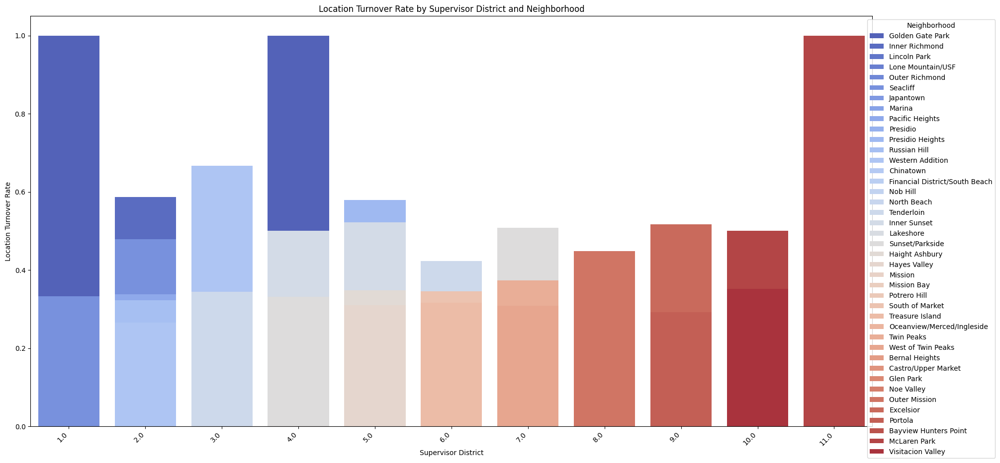

In [114]:

# location_turnover_rate is the DataFrame with 'Supervisor District', 'Neighborhood', and 'Turnover Rate' columns

# Create a bar plot with a different color scheme
plt.figure(figsize=(20, 10))
sns.barplot(
    x=location_turnover_rate.index.get_level_values(0),  # Supervisor District
    y=location_turnover_rate.values,
    hue=location_turnover_rate.index.get_level_values(1),  # Neighborhood
    palette='coolwarm',  # Change the color palette to 'cool'
    dodge=False  # Set dodge to False to make bars thicker with less gaps
)
plt.title('Location Turnover Rate by Supervisor District and Neighborhood')
plt.xlabel('Supervisor District')
plt.ylabel('Location Turnover Rate')
plt.xticks(rotation=45, ha='right')  # Rotate x-axis labels for readability
plt.legend(title='Neighborhood', loc='upper right', bbox_to_anchor=(1.15, 1))
plt.tight_layout()
plt.show()


Tax Analysis:

we create a feature that combines 'Parking Tax' and 'Transient Occupancy Tax' to measure the total tax burden on each business. Businesses with high tax burdens might be more likely to close.

In [115]:
# Ensure that the 'Parking Tax' and 'Transient Occupancy Tax' columns are numeric

df_sf['Parking Tax'] = pd.to_numeric(df_sf['Parking Tax'], errors='coerce')  # 'coerce' will handle non-numeric values as NaN
df_sf['Transient Occupancy Tax'] = pd.to_numeric(df_sf['Transient Occupancy Tax'], errors='coerce')

# Calculate the total tax burden as the sum of 'Parking Tax' and 'Transient Occupancy Tax'
df_sf['Total Tax Burden'] = df_sf['Parking Tax'] + df_sf['Transient Occupancy Tax']

# Display the modified DataFrame with the added column
#df_sf.head()

Market Saturation:

Calculate the number of businesses in the same NAICS code category within a certain radius of each business. High levels of competition could lead to closures.

Calculating Market Saturation by counting the number of businesses in the same NAICS code category within a certain radius of each business involves spatial analysis. You'll need geospatial data and tools to perform this analysis effectively. Here, I'll provide you with a high-level approach using Python libraries like GeoPandas and Shapely for spatial operations.

In [116]:
df_sf.shape  # lookup the df_sf shape. 

(46284, 49)

Using Plotly, we create a line graph that visualizes the counts of open and closed businesses in San Francisco over time. It's a useful visualization for tracking the dynamics of business openings and closures.

In [117]:
# Group by "Business Start Date" and count "Y" and "N"
grouped = df_sf.groupby(['Business Start Date', 'open']).size().unstack(fill_value=0)

# Reset the index to make it a regular DataFrame
grouped = grouped.reset_index()

# Rename the columns for clarity
grouped.columns = ['Business Start Date', 'Closed', 'Open']

# Create a line graph using Plotly


fig = px.line(grouped, x='Business Start Date', y=['Open', 'Closed'], title=" San Francisco Businesses Open and Closed Counts Over Time", template='plotly_white')
fig.update_layout(xaxis_title="Date", yaxis_title="Count", width=1200, height=800)
fig.show()

Using Plotly, We create an interactive line chart. The chart represents the saturation of business closures over time, broken down by Supervisor District. 

In [118]:

# Assuming you have a DataFrame 'df_sf' with the mentioned columns

import pandas as pd

# Assuming df_sf is your DataFrame
df_sf['Current Supervisor Districts'] = df_sf['Current Supervisor Districts'].replace(-1, 1)


# Convert the 'Business End Date' column to datetime if not done already
df_sf['Business End Date'] = pd.to_datetime(df_sf['Business End Date'])

# Group by Supervisor District and Month
grouped = df_sf.groupby(['Current Supervisor Districts', df_sf['Business End Date'].dt.to_period('M')])

# Define your saturation calculation function
def calculate_closures_saturation(group):
    # Calculate the number of businesses closed in the month
    return len(group)

# Apply the saturation calculation to each group and reset the index
closures_saturation = grouped.apply(calculate_closures_saturation).reset_index()

# Convert the 'Business End Date' to string or timestamp
closures_saturation['Business End Date'] = closures_saturation['Business End Date'].dt.to_timestamp()

# Create an interactive line chart
fig = px.line(closures_saturation, x='Business End Date', y=0, color='Current Supervisor Districts', labels={'Business End Date': 'Month', 0: 'Closures Saturation', 'Current Supervisor Districts': 'Supervisor District'})

# Customize the plot layout
fig.update_layout(
    title='Business Closures Saturation Over Time by Supervisor District',
    xaxis_title='Month',
    yaxis_title='Closures Saturation',
    legend_title='Supervisor District',
     width=1200,  # Set the width to 1000 pixels
    height=800,    # Set the height to 600 pixels
    template="plotly_white",
    
)

# Manually add Y grid lines
#fig.update_yaxes(showgrid=True, gridwidth=0.01, gridcolor='lightgray')

# # Change Y-axis ticks to go up in increments of 100
# fig.update_yaxes(dtick=100)




# Show the interactive plot
fig.show()




We use Plotly Express to create a distribution plot (histogram) that visualizes the distribution of business end dates by Supervisor Districts in San Francisco. 

In [119]:
# Create a distribution plot (histogram) using Plotly
fig = px.histogram(df_sf, x="Business End Date", color="Current Supervisor Districts", title="Distribution Plot of Business End Dates by Supervisor Districts")

# Customize the plot layout
fig.update_layout(
    xaxis_title="Business End Date",
    yaxis_title="Frequency",
    width=1500,
    height=800,
    template="plotly_white"
)

# Show the distribution plot
fig.show()

I create an interactive bar chart that visualizes the number of business openings and closures over time, with data categorized by Supervisor Districts. The chart provides a clear view of how business activity has evolved in each district over time and can help identify trends and patterns.

In [70]:

df_sf['Current Supervisor Districts'] = df_sf['Current Supervisor Districts'].replace(-1, 1)


# Convert 'Business Start Date' and 'Business End Date' to timestamps
df_sf['Business Start Date'] = pd.to_datetime(df_sf['Business Start Date'])
df_sf['Business End Date'] = pd.to_datetime(df_sf['Business End Date'])

# Group data by Supervisor District and calculate counts for openings and closures
grouped_openings = df_sf.groupby(['Current Supervisor Districts', df_sf['Business Start Date'].dt.to_period('M')])
openings_data = grouped_openings.size().reset_index(name='Openings')
grouped_closures = df_sf.groupby(['Current Supervisor Districts', df_sf['Business End Date'].dt.to_period('M')])
closures_data = grouped_closures.size().reset_index(name='Closures')

# Create a Plotly figure
fig = go.Figure()

# Add a bar chart for business openings
fig.add_trace(go.Bar(x=openings_data['Business Start Date'].dt.strftime('%Y-%m'), y=openings_data['Openings'], name='Openings', marker_color='blue', hovertemplate='District: %{x}<br>Closures: %{y}<extra></extra>'))

# Create a second Y-axis for business closures
fig.add_trace(go.Bar(x=closures_data['Business End Date'].dt.strftime('%Y-%m'), y=closures_data['Closures'], name='Closures', yaxis='y2', marker_color='red', hovertemplate='District: %{x}<br>Closures: %{y}<extra></extra>'))

# Define the layout for the chart
fig.update_layout(
    title='Business Openings and Closures Over Time by Supervisor District',
    xaxis=dict(title='Date'),
    yaxis=dict(title='Openings', titlefont=dict(color='blue')),
    yaxis2=dict(title='Closures', titlefont=dict(color='red'), overlaying='y', side='right'),
       width=1200,  # Set the width to 1000 pixels
    height=800,    # Set the height to 600 pixels
    template="plotly_white",
)


# Manually add Y grid lines
fig.update_yaxes(showgrid=True, gridwidth=0.01, gridcolor='lightgray')

# Show the interactive plot
fig.show()

I create a bar chart that provides insights into the count of unique business types based on the 'NAICS Code Description' column. This chart helps us understand the distribution of different business types in our dataset and identify the most prevalent or less common business categories.

In [121]:

df = df_sf.dropna(subset=['NAICS Code Description'])

# Count unique values in the "NAICS Code Description" column
unique_counts = df['NAICS Code Description'].value_counts().reset_index()
unique_counts.columns = ['NAICS Code Description', 'Count']

# Create a bar chart using Plotly
fig = px.bar(unique_counts, x='NAICS Code Description', y='Count', title="Unique Business Types Count", color='NAICS Code Description')

# Customize the plot layout
fig.update_layout(
    xaxis_title="NAICS Code Description",
    yaxis_title="Count",
    width=1200,
    height=800,
    template="plotly_white"
)

# Show the bar chart
fig.show()

I create a stacked line chart that allows us to explore the trends in the number of businesses closed each year, with the ability to see how these closures are distributed across different NAICS Code Descriptions. This type of chart help us to identify patterns in business closures over time within specific industry categories.

In [122]:

# Count the occurrences of each combination

df_counts = df_sf.groupby(['Year Closed', 'NAICS Code Description']).size().reset_index(name='Count')

# Create a stacked bar chart using Plotly
fig = px.line(df_counts, x="Year Closed", y="Count",color="NAICS Code Description", markers=True,
             title="Businesses Closed/Year by NAICS Code Description")

# Customize the plot layout
fig.update_layout(
    xaxis_title="Year",
    yaxis_title="Count",
    width=1500,
    height=600,
    template="plotly_white"
)

# Show the chart
fig.show()

I create a stacked bar chart that allows us to visualize the distribution of NAICS Code Descriptions for businesses closed in different years. The chart helps us to understand how business closures in specific industries have changed over time, and the stacked bars provide insights into the relative composition of closures by industry category.

In [180]:
# Create a stacked bar chart
fig = px.bar(grouped_data, x='Year Closed', y='count', color='NAICS Code Description',
             labels={'count': 'Occurrences'},
             title='Occurrences of NAICS Code Description by Year Closed',
             width=1200, height=700, template='plotly_white',
             barmode='stack')

fig.show()

I then select these subset of columns for further analysis. 

In [123]:
#select columns for further analysis

df_filt = df_sf[['Business Account Number','DBA Name','Business Start Date', 'Business End Date','Neighborhoods - Analysis Boundaries','Parking Tax',
                 'NAICS Code Description','Neighborhoods', 'Current Supervisor Districts','Transient Occupancy Tax','lifespan', 'open', 'latitude', 'longitude',
       'Year Opened', 'Month Opened', 'Quarter Opened', 'Day of Week Opened',
       'Year Closed', 'Month Closed', 'Quarter Closed', 'Day of Week Closed','Location Change Frequency', 'Ownership Change Frequency', 'Business Type Change', 'Location Turnover Rate', 'Total Tax Burden']]

I prepare the data for further analysis, by providing insights into daily closures, closure rates, and district-level closure statistics for businesses in San Francisco.

In [124]:
# Convert date columns to datetime
df_filt['Business Start Date'] = pd.to_datetime(df_filt['Business Start Date'])
df_filt['Business End Date'] = pd.to_datetime(df_filt['Business End Date'], errors='coerce')  # Convert to datetime, coerce errors

# Filter out rows where 'Business End Date' is empty (businesses that are still open)
df_closed = df_filt.dropna(subset=['Business End Date'])

# Calculate daily closed for each unique business in the filtered DataFrame
df_closed['Daily Closed'] = df_closed.groupby('Business Account Number')['Business End Date'].diff().dt.days * -1

# Calculate daily closed rate for each unique business in the filtered DataFrame
df_closed['Daily Closed Rate'] = df_closed.groupby('Business Account Number')['Daily Closed'].transform(lambda x: x / x.sum())

# Calculate daily closed and daily closed rates in each Current Supervisor District in the filtered DataFrame
district_daily_closed = df_closed.groupby('Current Supervisor Districts')['Daily Closed'].sum().reset_index()
district_daily_closed['District Daily Closed Rate'] = district_daily_closed['Daily Closed'] / district_daily_closed['Daily Closed'].sum()

# Merge the district closed information back into the original DataFrame
df_filt = df_filt.merge(district_daily_closed[['Current Supervisor Districts', 'Daily Closed', 'District Daily Closed Rate']],
                        on='Current Supervisor Districts', how='left')

# Display the resulting DataFrame
#df_filt.head()

/var/folders/2x/6pwz1dgs2z3_zd5ztxz6lsv80000gn/T/ipykernel_7206/1774526889.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/2x/6pwz1dgs2z3_zd5ztxz6lsv80000gn/T/ipykernel_7206/1774526889.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/2x/6pwz1dgs2z3_zd5ztxz6lsv80000gn/T/ipykernel_7206/1774526889.py:9: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the docu

We extract daily closure rates for each supervisor district, which can be used for further analysis and visualization to understand the temporal patterns of business closures across districts.

In [125]:
# Convert date columns to datetime objects
df_filt['Business Start Date'] = pd.to_datetime(df_filt['Business Start Date'])
df_filt['Business End Date'] = pd.to_datetime(df_filt['Business End Date'])

# Calculate the number of businesses closed each day for each district
df_filt['Business Closed'] = df_filt['Business End Date'].notnull().astype(int)

# Group by Supervisor District and Business Start Date, then sum the Business Closed column
district_close_counts = df_filt.groupby(['Current Supervisor Districts', 'Business Start Date'])['Business Closed'].sum().reset_index()

# Calculate the daily close rates for each district
district_close_rates = district_close_counts.pivot(index='Business Start Date', columns='Current Supervisor Districts', values='Business Closed').fillna(0)
district_close_rates = district_close_rates.divide(district_close_rates.sum(axis=1), axis=0)

# Merge the district_close_rates back into the original DataFrame df
df_filt = df_filt.merge(district_close_rates, left_on='Business Start Date', right_index=True, suffixes=('', '_CloseRate'))


# Print the result
#df_filt.head()


 I essentially filter the data to exclude rows with missing values in specific columns and then remove the 'District Daily Closed Rate' column from the DataFrame. This helps clean the data and prepare it for further analysis and modeling.

In [126]:
df_filt.dropna(subset=['Business Start Date', 'Current Supervisor Districts','NAICS Code Description', 'Neighborhoods - Analysis Boundaries', 'DBA Name', 1.0, 2.0, 3.0, 4.0, 5.0,6.0, 7.0, 8.0,9.0,10.0, 11.0], inplace=True)

# Drop the 'District Daily Closed Rate' column from df_filt
df_filt.drop('District Daily Closed Rate', axis=1, inplace=True)

# Print the updated DataFrame
#df_filt.head()


In [127]:
# List of columns to fill NaNs with 0
columns_to_fill_with_zero = ["Business Start Date", "Business End Date", "Year Closed", "Month Closed", "Quarter Closed", "Day of Week Closed"]

# Fill NaN values in the specified columns with 0
df_filt[columns_to_fill_with_zero] = df_filt[columns_to_fill_with_zero].fillna(0)

df_filt.isnull().sum()


Business Account Number                0
DBA Name                               0
Business Start Date                    0
Business End Date                      0
Neighborhoods - Analysis Boundaries    0
Parking Tax                            0
NAICS Code Description                 0
Neighborhoods                          0
Current Supervisor Districts           0
Transient Occupancy Tax                0
lifespan                               0
open                                   0
latitude                               0
longitude                              0
Year Opened                            0
Month Opened                           0
Quarter Opened                         0
Day of Week Opened                     0
Year Closed                            0
Month Closed                           0
Quarter Closed                         0
Day of Week Closed                     0
Location Change Frequency              0
Ownership Change Frequency             0
Business Type Ch

In [128]:
#filter down more usuable columns -

biz_df = df_filt[['Business Start Date', 'Neighborhoods - Analysis Boundaries', 'Parking Tax', 'NAICS Code Description', 'Neighborhoods','Current Supervisor Districts', 'Transient Occupancy Tax', 'lifespan', 'open', 'latitude', 'longitude', 'Year Opened', 'Month Opened', 'Quarter Opened', 'Day of Week Opened', 'Year Closed', 'Month Closed', 'Quarter Closed', 'Day of Week Closed', 'Business Closed', 'Location Change Frequency', 'Ownership Change Frequency', 'Business Type Change', 'Location Turnover Rate', 'Total Tax Burden', 1.0, 2.0, 3.0, 4.0, 5.0,6.0, 7.0, 8.0,9.0,10.0, 11.0]]
biz_df.shape

(29908, 36)

In [129]:
#reset Index

biz_df.reset_index(drop=True, inplace=True)

# Now, 'biz_df' will have its index reset to the default integer index
#biz_df.head()

In [130]:
# Convert the columns of df_filt to a list
columns_list = biz_df.columns.tolist()

# Print the list of columns
print(columns_list)

['Business Start Date', 'Neighborhoods - Analysis Boundaries', 'Parking Tax', 'NAICS Code Description', 'Neighborhoods', 'Current Supervisor Districts', 'Transient Occupancy Tax', 'lifespan', 'open', 'latitude', 'longitude', 'Year Opened', 'Month Opened', 'Quarter Opened', 'Day of Week Opened', 'Year Closed', 'Month Closed', 'Quarter Closed', 'Day of Week Closed', 'Business Closed', 'Location Change Frequency', 'Ownership Change Frequency', 'Business Type Change', 'Location Turnover Rate', 'Total Tax Burden', 1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, 9.0, 10.0, 11.0]


In [131]:
#create a subset of the original data, containing only the columns listed. 
minbiz_df = biz_df[['Business Start Date', 'Parking Tax','Current Supervisor Districts', 'Transient Occupancy Tax', 'lifespan', 'open', 'Year Opened', 'Month Opened', 'Quarter Opened', 'Day of Week Opened', 'Year Closed', 'Month Closed', 'Quarter Closed', 'Day of Week Closed', 'Business Closed', 'Location Change Frequency', 'Ownership Change Frequency', 'Business Type Change', 'Location Turnover Rate', 'Total Tax Burden', 1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, 9.0, 10.0, 11.0]]

In [133]:
minbiz_df.shape #see the shape of this df

(29908, 31)

### 4.2 San Francisco Transportation (BART) Data ###

The BART transportation DataFrame has a shape of 9678 rows and 13 columns. 

In [134]:
df_trv.shape

(9678, 13)

In [135]:
#display the data types of each column in the df_trv 
df_trv.dtypes

FY        object
Qtr       object
Month     object
Day       object
Date      object
EM       float64
MT       float64
PL       float64
CC       float64
16       float64
24       float64
GP       float64
BP       float64
dtype: object

 selecting and keeping specific columns in the DataFrame df_trv. 

In [136]:
columns_to_keep = ['Date', 'EM', 'MT', 'PL', 'CC', '16', '24',
       'GP', 'BP']
df_trv = df_trv[columns_to_keep]


In [137]:
# Define a dictionary to map old column names to new column names
column_name_mapping = {
    'EM': 'Embarcadero',
    'MT': 'Montgomery',
    'PL': 'Powell St',
    'CC': 'Civic Center',
    '16': '16th Mission',
    '24': '24th Mission',
    'GP': 'Glen Park',
    'BP': 'Balboa Park'
}

# Use the rename method to rename the columns
df_trv.rename(columns=column_name_mapping, inplace=True)

# Print the DataFrame with the updated column names
#df_trv.head()

In [138]:
#filter only last 5 years

df_trv = df_trv[df_trv['Date'] >= '09-01-2018']
df_trv.reset_index(drop=True, inplace=True)

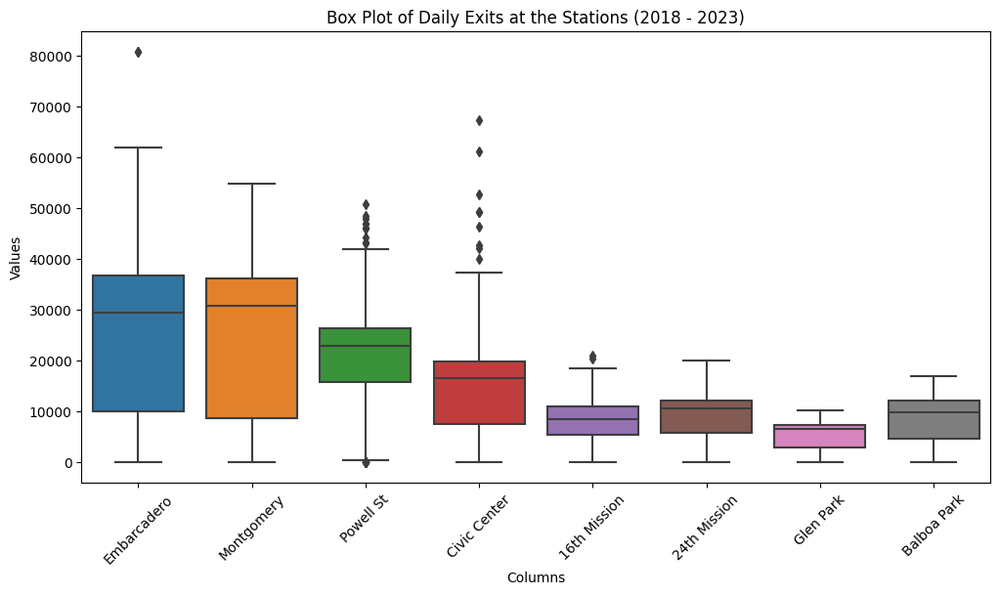

In [139]:
# Columns to include in the box plot
columns_to_plot = ['Day', 'Embarcadero', 'Montgomery', 'Powell St', 'Civic Center', '16th Mission', '24th Mission', 'Glen Park', 'Balboa Park']

# Create a box plot
plt.figure(figsize=(12, 6))  # Optional: adjust the figure size
sns.boxplot(data =df_trv) #data=df_trv[columns_to_plot])
plt.xlabel('Columns')
plt.ylabel('Values')
plt.title('Box Plot of Daily Exits at the Stations (2018 - 2023)')
plt.xticks(rotation=45)  # Rotate x-axis labels for better readability

# Show the plot
plt.show()

In [142]:
# Remove rows with missing values from the DataFrame
df_trv.dropna(inplace=True)


In [143]:
# Extract year, month, quarter, and day of the week for the end date
# Assuming 'Date' is in a string format, convert it to a datetime object
df_trv['Date'] = pd.to_datetime(df_trv['Date'])

# Extract year, month, quarter, and day of the week for the end date
df_trv['Year'] = df_trv['Date'].dt.year
df_trv['Month'] = df_trv['Date'].dt.month
df_trv['Quarter'] = df_trv['Date'].dt.quarter
df_trv['DayOfWeek'] = df_trv['Date'].dt.day_name()

#df_trv.head()

In [144]:

# Define the columns to be plotted
columns_to_plot = ['Embarcadero', 'Montgomery', 'Powell St', 'Civic Center', '16th Mission', '24th Mission', 'Glen Park', 'Balboa Park']

# Create a line plot
fig = px.line(df_trv, x='Date', y=columns_to_plot, labels={'Date': 'Date', 'value': 'Station Value'},
              title='Line Plot of Eight San Francisco BART Stations Over Time', width=1200,height=600, template='plotly_white')

fig.show()


In [145]:
# Reshape the DataFrame to long-form
df_long = df_trv.melt(value_vars=['Embarcadero', 'Montgomery', 'Powell St', 'Civic Center', '16th Mission', '24th Mission', 'Glen Park', 'Balboa Park'])

# Create a horizontal boxplot
fig = px.box(df_long, x='value', y='variable', title='Boxplot of San Francisco BART Stations Traffic Volumes', width=1000, height=600, template='plotly_white')

fig.update_xaxes(title_text='Daily Traffic Volumes')
fig.update_yaxes(title_text='Stations')

fig.show()


In [146]:
# Reshape the DataFrame to long-form
df_long = df_trv.melt(id_vars='DayOfWeek', value_vars=['Embarcadero', 'Montgomery', 'Powell St', 'Civic Center', '16th Mission', '24th Mission', 'Glen Park', 'Balboa Park'])

# Create a horizontal boxplot
fig = px.scatter(df_long, x='DayOfWeek', y='value', color='variable', title='Boxplot of Stations by Day of the Week', width=800, height=400)

fig.update_xaxes(title_text='Day of the Week')
fig.update_yaxes(title_text='Values')

fig.show()


In [149]:
# Assuming you have a DataFrame 'df_trv' with station columns and 'DayOfWeek' column

# Select the station columns and weekdays to include
selected_stations = ['Embarcadero', 'Montgomery', 'Powell St', 'Civic Center', '16th Mission', '24th Mission', 'Glen Park', 'Balboa Park']
selected_weekdays = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']

# Filter the DataFrame for the selected station columns and weekdays
filtered_df = df_trv[df_trv['DayOfWeek'].isin(selected_weekdays)][['DayOfWeek'] + selected_stations]

# Reshape the DataFrame into long-form
melted_df = pd.melt(filtered_df, id_vars='DayOfWeek', value_vars=selected_stations, var_name='Station', value_name='Traffic')

# Create a plot using Plotly Express
fig = px.bar(melted_df, x='DayOfWeek', y='Traffic', color='Station', title='Traffic by Station and Day of the Week',template='plotly_dark')

fig.show()



In [150]:
#Prepare travel df to be merged to minbiz_df

mintrv_df = df_trv[['Date', 'Embarcadero', 'Montgomery', 'Powell St', 'Civic Center',
       '16th Mission', '24th Mission', 'Glen Park', 'Balboa Park']]

#mintrv_df.head()

In [151]:
# Perform an inner join on 'Business Start Date' and 'Date'
test_df1 = pd.merge(minbiz_df, mintrv_df, left_on='Business Start Date', right_on='Date', how='inner')

# Display the merged dataframe

#test_df1.head()

In [95]:
#test_df1.shape

In [152]:
# Fill missing values with 0 (or any other appropriate value)
test_df1 = test_df1.fillna(0)

# Save the DataFrame to a CSV file
test_df1.to_csv('test_df1.csv', index=False)  # Specify index=False to exclude the index column from the CSV


### 4.3 San Francisco Crime Data ##

select only these columns to match the other crime df filtered columns

['PdId', 'IncidntNum', 'Incident Code', 'Category', 'Descript',
       'DayOfWeek', 'Date', 'Time', 'PdDistrict', 'Resolution', 'Address',
       'Longitude', 'Latitude', 'location', 'SF Find Neighborhoods 2 2',
       'Current Police Districts 2 2', 'Current Supervisor Districts 2 2',
       'Analysis Neighborhoods 2 2', 'Areas of Vulnerability, 2016 2 2',
       'Neighborhoods 2'

In [153]:
df_pol2_filt = df_pol3[['Incident Date', 'Incident Time', 'Incident Year',
       'Incident Day of Week', 'Incident Category', 'Incident Code', 'Incident ID', 'Resolution', 'Police District', 'Latitude', 'Longitude', 'Current Supervisor Districts', 'Current Police Districts', 'Analysis Neighborhood', 'Neighborhoods']]

In [154]:
df_pol2_filt.dtypes

Incident Date                    object
Incident Time                    object
Incident Year                     int64
Incident Day of Week             object
Incident Category                object
Incident Code                     int64
Incident ID                       int64
Resolution                       object
Police District                  object
Latitude                        float64
Longitude                       float64
Current Supervisor Districts    float64
Current Police Districts        float64
Analysis Neighborhood            object
Neighborhoods                   float64
dtype: object

In [155]:
# Assuming 'Incident Date' is originally in the format 'YYYY/MM/DD'
df_pol2_filt['Incident Date'] = pd.to_datetime(df_pol2_filt['Incident Date'], format='%Y/%m/%d')

# Change the format to 'M-D-Y'
df_pol2_filt['Incident Date'] = df_pol2_filt['Incident Date'].dt.strftime('%m-%d-%Y')


#df_pol2_filt['Incident Date'] = pd.to_datetime(df_pol2_filt['Incident Date'], format='%m-%d-%Y')


/var/folders/2x/6pwz1dgs2z3_zd5ztxz6lsv80000gn/T/ipykernel_7206/490734540.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/2x/6pwz1dgs2z3_zd5ztxz6lsv80000gn/T/ipykernel_7206/490734540.py:5: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [156]:
df_pol2_filt.dtypes

Incident Date                    object
Incident Time                    object
Incident Year                     int64
Incident Day of Week             object
Incident Category                object
Incident Code                     int64
Incident ID                       int64
Resolution                       object
Police District                  object
Latitude                        float64
Longitude                       float64
Current Supervisor Districts    float64
Current Police Districts        float64
Analysis Neighborhood            object
Neighborhoods                   float64
dtype: object

In [157]:
df_pol2_filt = df_pol2_filt[df_pol2_filt['Incident Date'] >= '09-01-2018']
df_pol2_filt.reset_index(drop=True, inplace=True)


In [158]:
# Filter out rows with 'Police District' equal to "Out of SF"
df_pol2_filt = df_pol2_filt[df_pol2_filt['Police District'] != 'Out of SF']


In [159]:
#drop resolution column

df_pol2_filt.drop(columns=['Resolution',], inplace=True)

In [160]:
df_pol2_filt['Incident Category'].value_counts()

Incident Category
Larceny Theft                                 78040
Other Miscellaneous                           16699
Malicious Mischief                            16389
Assault                                       15187
Non-Criminal                                  14340
Burglary                                      13389
Motor Vehicle Theft                           13380
Fraud                                          7324
Recovered Vehicle                              7287
Warrant                                        6926
Lost Property                                  6327
Drug Offense                                   5737
Robbery                                        5645
Missing Person                                 5122
Suspicious Occ                                 4964
Disorderly Conduct                             4132
Offences Against The Family And Children       3275
Miscellaneous Investigation                    2557
Traffic Violation Arrest                      

In [161]:
#filter crime df with only these categories of crimesf

filt_cat = ['Larceny Theft', 'Burglary']

crime_df = df_pol2_filt[df_pol2_filt['Incident Category'].isin(filt_cat)]
crime_df.shape

(91429, 14)

In [162]:
#resetting the index of the DataFrame crime_df and updating it in place. 
crime_df.reset_index(drop=True, inplace=True)
#crime_df.head()

In [20]:
crime_df.dropna(inplace=True)
crime_df.reset_index(drop=True, inplace=True)

/var/folders/2x/6pwz1dgs2z3_zd5ztxz6lsv80000gn/T/ipykernel_7206/2694683487.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  crime_df.dropna(inplace=True)


In [163]:
crime_df.shape

(91429, 14)

In [164]:
#randomly sample 1000 rows from crime_df for plotting

samp_df = crime_df.sample(n=1000, random_state=42)
#samp_df.head()


In [165]:
# use DataFrame columns named 'latitude' and 'longitude'
samp_df['geometry'] = samp_df.apply(lambda row: Point(row['Longitude'], row['Latitude']), axis=1)

# Convert the DataFrame to a GeoDataFrame
samp_gdf = gpd.GeoDataFrame(samp_df, geometry='geometry')


In [166]:
#using the geopandas library to read a shapefile and store its data in a GeoDataFrame gdf. 
gdf = gpd.read_file('/Users/baboo/Desktop/SF/shapefile_dir/geo_export_a8936f1d-7450-479f-8d16-b0e0cfd03812.shp')

In [167]:
#using the folium library to create an interactive map and add markers for locations specified in the DataFrame samp_df. 
import folium


sf_cood = (37.76, -122.45)
_map = folium.Map(location=sf_cood, zoom_start=12)

# Iterate through your DataFrame to add markers
for index, row in samp_df.iterrows():
    folium.Marker(
        location=[row["Latitude"], row["Longitude"]],
        clustered_marker=True  # This will enable marker clustering
    ).add_to(_map)

_map  # Display the map in a Jupyter Notebook or a compatible IDE


ValueError: Location values cannot contain NaNs.

In [ ]:
# Calculate daily crime counts
daily_crime_counts = crime_df.groupby('Incident Date').size().reset_index(name='Daily Crimes')

# Calculate supervisor district-wise crime counts
supervisor_district_crime_counts = crime_df.groupby('Current Supervisor Districts').size().reset_index(name='District Crimes')

# Merge daily crime counts with the original DataFrame
crime_df = pd.merge(crime_df, daily_crime_counts, on='Incident Date', how='left')

# Merge supervisor district-wise crime counts with the original DataFrame
crime_df = pd.merge(crime_df, supervisor_district_crime_counts, on='Current Supervisor Districts', how='left')

# Calculate daily crime rates
crime_df['Daily Crime Rate'] = crime_df['Daily Crimes'] / 1  # You can use a denominator like the total number of days

# Calculate supervisor district-wise crime rates
crime_df['Supervisor District Crime Rate'] = crime_df['District Crimes'] / crime_df['District Crimes'].sum()

# Display the resulting DataFrame
#crime_df.head()


,Incident Date,Incident Time,Incident Year,Incident Day of Week,Incident Category,Incident Code,Incident ID,Police District,Latitude,Longitude,Current Supervisor Districts,Current Police Districts,Analysis Neighborhood,Neighborhoods,Daily Crimes,District Crimes,Daily Crime Rate,Supervisor District Crime Rate
0,10-27-2021,12:45,2021,Wednesday,Larceny Theft,6373,1085412,Taraval,37.726950,-122.476039,8.0,10.0,Lakeshore,41.0,104,4130,104.0,0.000005
1,10-13-2021,10:58,2021,Wednesday,Larceny Theft,6374,1088021,Central,37.788178,-122.416827,3.0,6.0,Nob Hill,50.0,150,15716,150.0,0.000020
2,09-06-2021,04:30,2021,Monday,Larceny Theft,71013,1067713,Bayview,37.755214,-122.390922,9.0,2.0,Potrero Hill,55.0,115,6297,115.0,0.000008
3,12-01-2021,18:00,2021,Wednesday,Burglary,5071,1122350,Mission,37.752074,-122.421143,5.0,3.0,Mission,53.0,163,6610,163.0,0.000008
4,09-29-2021,04:11,2021,Wednesday,Burglary,5051,1075181,Central,37.789226,-122.408595,3.0,6.0,Nob Hill,19.0,117,15716,117.0,0.000020


In [26]:
# !pip install geoplot

using IPython to display an HTML file in the Jupyter Notebook environment. 

In [ ]:
from IPython.display import HTML

HTML(filename="crime_choropleth_map.html")

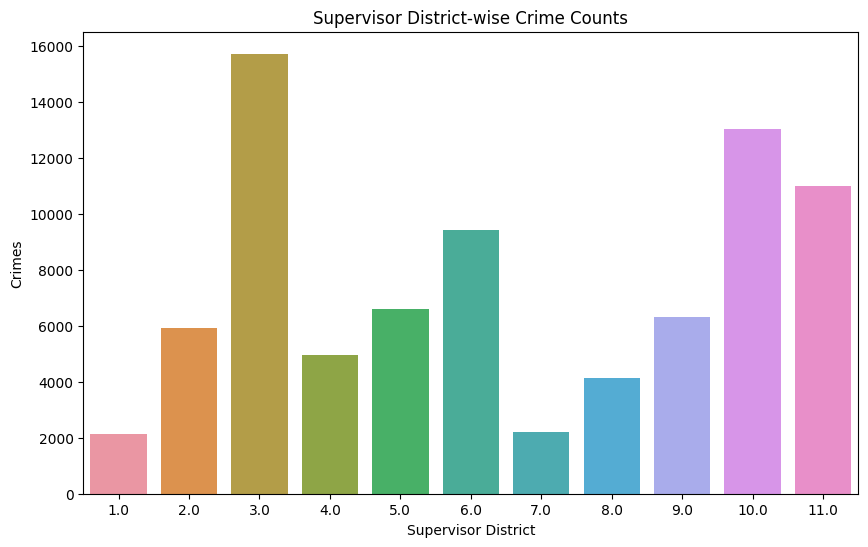

In [ ]:
# Create a bar plot using Seaborn
plt.figure(figsize=(10, 6))  # Adjust the figure size as needed
sns.barplot(data=crime_df, x='Current Supervisor Districts', y='District Crimes')
plt.xlabel('Supervisor District')
plt.ylabel('Crimes')
plt.title('Supervisor District-wise Crime Counts')

# Show the plot
plt.show()

In [ ]:
# using DataFrame 'crime_df' with columns 'Incident Year', 'Current Supervisor Districts', and 'Incident Category'

# Group by 'Incident Year' and 'Current Supervisor Districts' and count the number of rows for each combination
grouped_data = crime_df.groupby(['Incident Year', 'Current Supervisor Districts'])['Incident Category'].count().reset_index()

# Create a bar plot using Plotly Express
fig = px.bar(grouped_data, x='Incident Year', y='Incident Category', color='Current Supervisor Districts',template="plotly_white",
             title='Incident Category Count by Year and Districts')

fig.update_xaxes(title_text='Year')
fig.update_yaxes(title_text='Incident Category Count')

fig.show()


San Francisco Districts 11 and 10 seem to consistently have the most crime counts each year/per year as per our data.

In [ ]:
#filter out features for Model

mincrime_df = crime_df[['Incident Date','Current Supervisor Districts', 'Daily Crimes', 'District Crimes', 'Daily Crime Rate', 'Supervisor District Crime Rate']]
mincrime_df = mincrime_df.reset_index(drop=True)

##mincrime_df.head()

,Incident Date,Current Supervisor Districts,Daily Crimes,District Crimes,Daily Crime Rate,Supervisor District Crime Rate
0,10-27-2021,8.0,104,4130,104.0,0.000005
1,10-13-2021,3.0,150,15716,150.0,0.000020
2,09-06-2021,9.0,115,6297,115.0,0.000008
3,12-01-2021,5.0,163,6610,163.0,0.000008
4,09-29-2021,3.0,117,15716,117.0,0.000020


In [ ]:
# Convert 'Incident Date' to year-month-day format

mincrime_df['Incident Date'] = pd.to_datetime(mincrime_df['Incident Date'], format='%m-%d-%Y').dt.strftime('%Y-%m-%d')

#mincrime_df.head()

,Incident Date,Current Supervisor Districts,Daily Crimes,District Crimes,Daily Crime Rate,Supervisor District Crime Rate
0,2021-10-27,8.0,104,4130,104.0,0.000005
1,2021-10-13,3.0,150,15716,150.0,0.000020
2,2021-09-06,9.0,115,6297,115.0,0.000008
3,2021-12-01,5.0,163,6610,163.0,0.000008
4,2021-09-29,3.0,117,15716,117.0,0.000020


In [ ]:
#saving the DataFrame mincrime_df to a CSV (Comma-Separated Values) file named "mincrime_df.csv." 
mincrime_df.to_csv('mincrime_df.csv')

In [ ]:
test_df1 = test_df1.reset_index(drop=True)

test_df1.head(-35)
#reset test_df index also

NameError: name 'test_df1' is not defined

In [ ]:
# test_df1.merge(mincrime_df, how='left', on='Current Supervisor Districts')

: 

In [168]:
# # Convert the 'Current Supervisor Districts' column in 'mincrime_df' to int
# mincrime_df['Current Supervisor Districts'] = mincrime_df['Current Supervisor Districts'].astype(int)

# # Convert the 'Current Supervisor Districts' column in 'mincrime_df' to int
# test_df1['Current Supervisor Districts'] = test_df1['Current Supervisor Districts'].astype(int)


In [184]:
# Concatenate DataFrames along columns (side by side)
concatenated_df = pd.concat([test_df1, mincrime_df], axis=1)

# Display the concatenated DataFrame
concatenated_df.shape

(251514, 48)

In [187]:
# Rename the fourth column from the end (negative index -4)
new_column_name = 'Current Supervisor Districts Crimes'  # Replace with your desired new name
column_index_to_rename = concatenated_df.columns[-4]

# Rename the column
concatenated_df.rename(columns={column_index_to_rename: new_column_name}, inplace=True)


In [204]:
concatenated_df.shape

(32746, 48)

In [193]:
# Drop rows with missing values
concatenated_df.dropna(inplace=True)

# Display the DataFrame after dropping rows with NaN values
concatenated_df.shape


(32746, 48)

In [194]:
concatenated_df.to_csv('concatenated_df.csv')

# 5. Machine Learning #

### 5.1 Data loading ###

In [44]:
#read a CSV file and store its data in a DataFrame named df_finito.
df_finito = pd.read_csv('/Users/baboo/Desktop/SF/concatenated_df.csv')

In [45]:
df_finito.head()

,Unnamed: 0,Business Start Date,Parking Tax,Current Supervisor Districts,Transient Occupancy Tax,lifespan,open,Year Opened,Month Opened,Quarter Opened,Day of Week Opened,Year Closed,Month Closed,Quarter Closed,Day of Week Closed,Business Closed,Location Change Frequency,Ownership Change Frequency,Business Type Change,Location Turnover Rate,Total Tax Burden,1.0,2.0,3.0,4.0,5.0,6.0,7.0,8.0,9.0,10.0,11.0,Date,Embarcadero,Montgomery,Powell St,Civic Center,16th Mission,24th Mission,Glen Park,Balboa Park,year,month,Incident Date,Current Supervisor Districts.1,Current Supervisor Districts Crimes,District Crimes,Daily Crime Rate,Supervisor District Crime Rate
0,0,2020-01-01,False,4.0,False,1.0,N,2020.0,1.0,1.0,Wednesday,2021.0,10.0,4.0,0.0,1.0,1.0,1.0,1.0,0.306452,False,0.015444,0.069498,0.108108,0.069498,0.081081,0.07722,0.050193,0.050193,0.100386,0.274131,0.104247,2020-01-01,5011.0,3723.0,9450.0,3039.0,2521.0,2691.0,1581.0,2420.0,2020.0,1.0,2021/10/27,8,104,12736,104.0,0.000002
1,1,2020-01-01,False,4.0,False,0.0,Y,2020.0,1.0,1.0,Wednesday,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,0.272487,False,0.015444,0.069498,0.108108,0.069498,0.081081,0.07722,0.050193,0.050193,0.100386,0.274131,0.104247,2020-01-01,5011.0,3723.0,9450.0,3039.0,2521.0,2691.0,1581.0,2420.0,2020.0,1.0,2021/10/13,3,150,48011,150.0,0.000006
2,2,2020-01-01,False,4.0,False,0.0,Y,2020.0,1.0,1.0,Wednesday,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,0.306452,False,0.015444,0.069498,0.108108,0.069498,0.081081,0.07722,0.050193,0.050193,0.100386,0.274131,0.104247,2020-01-01,5011.0,3723.0,9450.0,3039.0,2521.0,2691.0,1581.0,2420.0,2020.0,1.0,2021/09/06,9,115,19967,115.0,0.000003
3,3,2020-01-01,False,4.0,False,0.0,N,2020.0,1.0,1.0,Wednesday,2020.0,10.0,4.0,2.0,1.0,1.0,1.0,1.0,0.306452,False,0.015444,0.069498,0.108108,0.069498,0.081081,0.07722,0.050193,0.050193,0.100386,0.274131,0.104247,2020-01-01,5011.0,3723.0,9450.0,3039.0,2521.0,2691.0,1581.0,2420.0,2020.0,1.0,2021/12/01,5,163,20341,163.0,0.000003
4,4,2020-01-01,False,4.0,False,0.0,N,2020.0,1.0,1.0,Wednesday,2020.0,8.0,3.0,6.0,1.0,1.0,1.0,1.0,0.306452,False,0.015444,0.069498,0.108108,0.069498,0.081081,0.07722,0.050193,0.050193,0.100386,0.274131,0.104247,2020-01-01,5011.0,3723.0,9450.0,3039.0,2521.0,2691.0,1581.0,2420.0,2020.0,1.0,2021/09/29,3,117,48011,117.0,0.000006


In [46]:
# Drop the 'Current Supervisor Districts Crimes' column
df_finito.drop(['Unnamed: 0','lifespan', 'Current Supervisor Districts Crimes','Year Closed', 'Month Closed', 'Quarter Closed', 'Business Closed', 'Business Start Date','Date', 'Incident Date'], axis=1, inplace=True)

# Display the DataFrame after dropping the column
df_finito.head()


,Parking Tax,Current Supervisor Districts,Transient Occupancy Tax,open,Year Opened,Month Opened,Quarter Opened,Day of Week Opened,Day of Week Closed,Location Change Frequency,Ownership Change Frequency,Business Type Change,Location Turnover Rate,Total Tax Burden,1.0,2.0,3.0,4.0,5.0,6.0,7.0,8.0,9.0,10.0,11.0,Embarcadero,Montgomery,Powell St,Civic Center,16th Mission,24th Mission,Glen Park,Balboa Park,year,month,Current Supervisor Districts.1,District Crimes,Daily Crime Rate,Supervisor District Crime Rate
0,False,4.0,False,N,2020.0,1.0,1.0,Wednesday,0.0,1.0,1.0,1.0,0.306452,False,0.015444,0.069498,0.108108,0.069498,0.081081,0.07722,0.050193,0.050193,0.100386,0.274131,0.104247,5011.0,3723.0,9450.0,3039.0,2521.0,2691.0,1581.0,2420.0,2020.0,1.0,8,12736,104.0,0.000002
1,False,4.0,False,Y,2020.0,1.0,1.0,Wednesday,0.0,1.0,1.0,1.0,0.272487,False,0.015444,0.069498,0.108108,0.069498,0.081081,0.07722,0.050193,0.050193,0.100386,0.274131,0.104247,5011.0,3723.0,9450.0,3039.0,2521.0,2691.0,1581.0,2420.0,2020.0,1.0,3,48011,150.0,0.000006
2,False,4.0,False,Y,2020.0,1.0,1.0,Wednesday,0.0,1.0,1.0,1.0,0.306452,False,0.015444,0.069498,0.108108,0.069498,0.081081,0.07722,0.050193,0.050193,0.100386,0.274131,0.104247,5011.0,3723.0,9450.0,3039.0,2521.0,2691.0,1581.0,2420.0,2020.0,1.0,9,19967,115.0,0.000003
3,False,4.0,False,N,2020.0,1.0,1.0,Wednesday,2.0,1.0,1.0,1.0,0.306452,False,0.015444,0.069498,0.108108,0.069498,0.081081,0.07722,0.050193,0.050193,0.100386,0.274131,0.104247,5011.0,3723.0,9450.0,3039.0,2521.0,2691.0,1581.0,2420.0,2020.0,1.0,5,20341,163.0,0.000003
4,False,4.0,False,N,2020.0,1.0,1.0,Wednesday,6.0,1.0,1.0,1.0,0.306452,False,0.015444,0.069498,0.108108,0.069498,0.081081,0.07722,0.050193,0.050193,0.100386,0.274131,0.104247,5011.0,3723.0,9450.0,3039.0,2521.0,2691.0,1581.0,2420.0,2020.0,1.0,3,48011,117.0,0.000006


In [47]:
df_finito.columns

Index(['Parking Tax', 'Current Supervisor Districts',
       'Transient Occupancy Tax', 'open', 'Year Opened', 'Month Opened',
       'Quarter Opened', 'Day of Week Opened', 'Day of Week Closed',
       'Location Change Frequency', 'Ownership Change Frequency',
       'Business Type Change', 'Location Turnover Rate', 'Total Tax Burden',
       '1.0', '2.0', '3.0', '4.0', '5.0', '6.0', '7.0', '8.0', '9.0', '10.0',
       '11.0', 'Embarcadero', 'Montgomery', 'Powell St', 'Civic Center',
       '16th Mission', '24th Mission', 'Glen Park', 'Balboa Park', 'year',
       'month', 'Current Supervisor Districts.1', 'District Crimes',
       'Daily Crime Rate', 'Supervisor District Crime Rate'],
      dtype='object')

In [48]:

# Rename the 'Current Supervisor Districts.1' column to 'Current Supervisor Districts Crimes'
df_finito.rename(columns={'Current Supervisor Districts.1': 'Current Supervisor Districts Crimes'}, inplace=True)

df_finito.shape

(32746, 39)

In [50]:
df_finito.dtypes

Parking Tax                               bool
Current Supervisor Districts           float64
Transient Occupancy Tax                   bool
open                                    object
Year Opened                            float64
Month Opened                           float64
Quarter Opened                         float64
Day of Week Opened                      object
Day of Week Closed                     float64
Location Change Frequency              float64
Ownership Change Frequency             float64
Business Type Change                   float64
Location Turnover Rate                 float64
Total Tax Burden                          bool
1.0                                    float64
2.0                                    float64
3.0                                    float64
4.0                                    float64
5.0                                    float64
6.0                                    float64
7.0                                    float64
8.0          

In [51]:
#checking for data imbalance

# Count the number of instances in each class
class_counts = df_finito['open'].value_counts()
print(class_counts)

open
Y    22270
N    10476
Name: count, dtype: int64


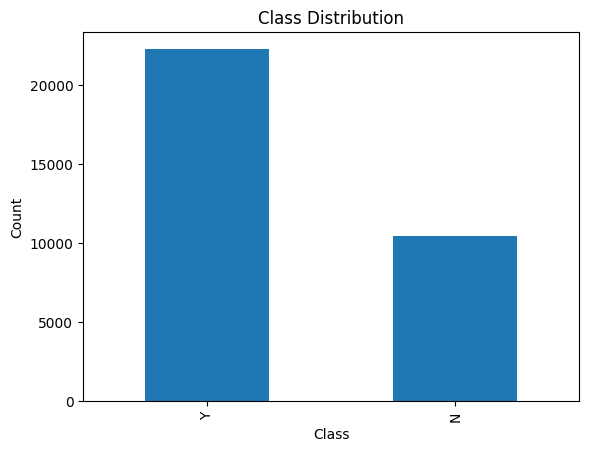

In [52]:
import matplotlib.pyplot as plt

# Plot class distribution
class_counts.plot(kind='bar')
plt.xlabel('Class')
plt.ylabel('Count')
plt.title('Class Distribution')
plt.show()


In [53]:
#calculating the class imbalance ratio for our binary classification problem.

ratio = class_counts[1] / class_counts[0]  
print(f'Class Imbalance Ratio: {ratio}')


Class Imbalance Ratio: 0.4704086214638527


The class imbalance ratio you calculated is approximately 0.4704. This ratio represents the ratio of the number of instances in the minority class ('N') to the number of instances in the majority class ('Y'). Specifically, it means that the number of instances in the minority class is about 47.04% of the number of instances in the majority class.

The imbalance is significant, as the minority class is considerably smaller than the majority class. 

### 5.2. Data Splitting ###

In [54]:
# Set the target variable
y = df_finito['open']

# Define your feature matrix (X) by excluding the 'open' column
X = df_finito.drop('open', axis=1)

In [56]:
categorical_cols = ['Parking Tax', 'Transient Occupancy Tax', 'Day of Week Opened', 'Total Tax Burden']
# numerical_cols = ['Current Supervisor Districts', 'Year Opened', 'Month Opened', 'Quarter Opened',
#                   'Location Change Frequency', 'Ownership Change Frequency', 'Business Type Change',
#                   'Location Turnover Rate', '1.0', '2.0', '3.0', '4.0', '5.0', '6.0', '7.0', '8.0', '9.0', '10.0',
#                   '11.0', 'Embarcadero', 'Montgomery', 'Powell St', 'Civic Center', '16th Mission', '24th Mission',
#                   'Glen Park', 'Balboa Park', 'year', 'month', 'Current Supervisor Districts Crimes', 'District Crimes',
#                   'Daily Crime Rate', 'Supervisor District Crime Rate']

numerical_cols = ['Current Supervisor Districts', 'Year Opened', 'Month Opened', 'Quarter Opened',
                  'Location Change Frequency', 'Ownership Change Frequency', 'Business Type Change',
                  'Location Turnover Rate', '1.0', '2.0', '3.0', '4.0', '5.0', '6.0', '7.0', '8.0', '9.0', '10.0',
                  '11.0', 'Embarcadero', 'Montgomery', 'Powell St', 'Civic Center', '16th Mission', '24th Mission',
                  'Glen Park', 'Balboa Park', 'year', 'month', 'District Crimes',
                  'Daily Crime Rate', 'Supervisor District Crime Rate']


label_encoders = {}

for col in categorical_cols:
    label_encoder = LabelEncoder()
    df_finito[col] = label_encoder.fit_transform(df_finito[col])
    label_encoders[col] = label_encoder

random_seed = 42  # random seed
X = df_finito[numerical_cols + categorical_cols]
y = df_finito['open']  #  target variable

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=random_seed)


In [57]:
#displaying the shapes of our arrays 
X_train.shape, X_test.shape, y_train.shape, y_test.shape

((26196, 36), (6550, 36), (26196,), (6550,))

### Feature Selection using Pearson Correlation ###

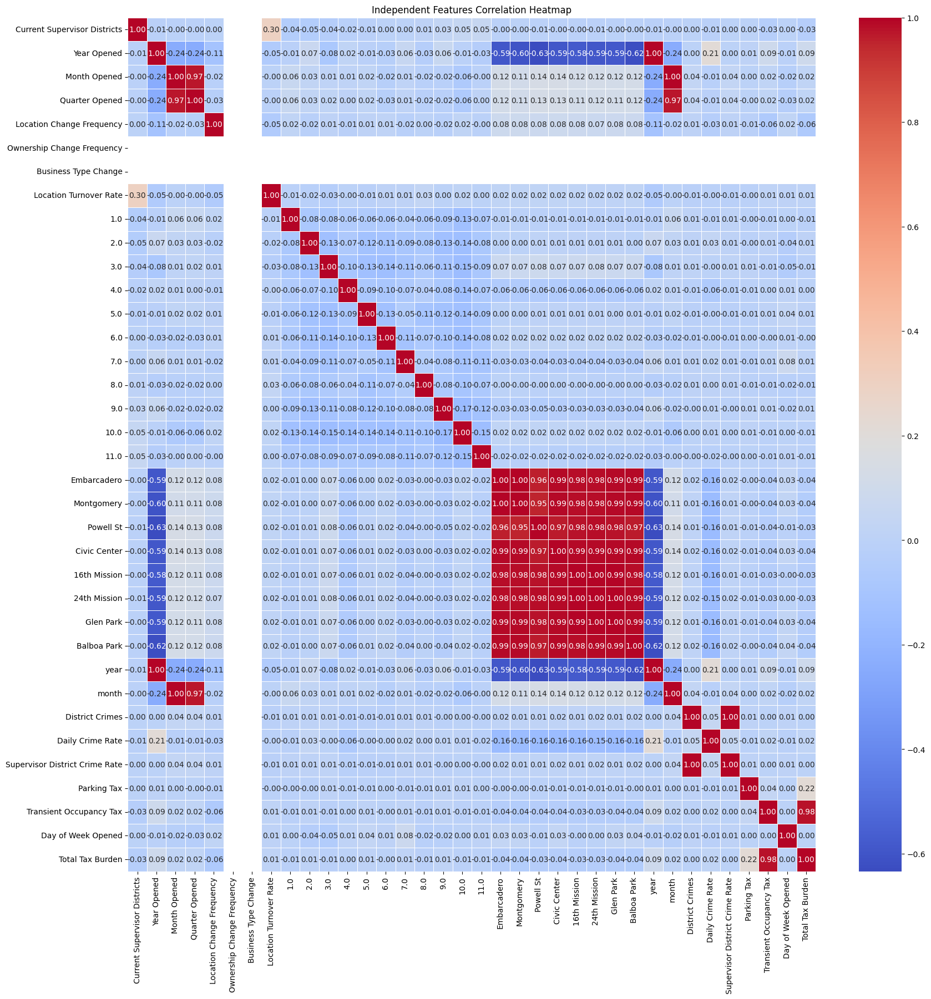

In [59]:
#generates a heatmap that visualizes the correlation between independent features in your dataset. 
plt.figure(figsize=(20, 20))
cor = X_train.corr()
sns.heatmap(cor, annot=True, fmt=".2f", cmap="coolwarm", linewidths=0.5)
plt.title("Independent Features Correlation Heatmap")
plt.show()

In [60]:
# with the following function we can select highly correlated features
# it will remove the first feature that is correlated with anything other feature

def correlation(dataset, threshold):
    col_corr = set()  # Set of all the names of correlated columns
    corr_matrix = dataset.corr()
    for i in range(len(corr_matrix.columns)):
        for j in range(i):
            if abs(corr_matrix.iloc[i, j]) > threshold: # we are interested in absolute coeff value
                colname = corr_matrix.columns[i]  # getting the name of column
                col_corr.add(colname)
    return col_corr

Identifying highly correlated features is an essential step in feature selection or engineering, as it helps reduce multicollinearity, which can improve the performance and interpretability of machine learning models. Once identified, you can decide whether to keep, remove, or transform these features based on the specific requirements of your analysis or modeling task.

In [61]:
# Set the threshold value
threshold = 0.85

# Call the correlation function to find correlated features with the specified threshold
corr_features = correlation(X_train, threshold)

# Calculate the length of the set
corr_feature_count = len(corr_features)

print("Number of correlated features with threshold", threshold, ":", corr_feature_count)



Number of correlated features with threshold 0.85 : 12


In [62]:
#print highly correlated features as per pearson

corr_features

{'16th Mission',
 '24th Mission',
 'Balboa Park',
 'Civic Center',
 'Glen Park',
 'Montgomery',
 'Powell St',
 'Quarter Opened',
 'Supervisor District Crime Rate',
 'Total Tax Burden',
 'month',
 'year'}

In [63]:
#X remove highly correlated features

# List of columns to remove
columns_to_remove = ['16th Mission', '24th Mission', 'Balboa Park', 'Civic Center', 'Glen Park',
                     'Montgomery', 'Powell St', 'Quarter Opened', 'Supervisor District Crime Rate',
                     'Total Tax Burden', 'month', 'year']

# Remove the columns from X_train
X_train = X_train.drop(columns=columns_to_remove)
X_test = X_test.drop(columns=columns_to_remove)

In [34]:
X_test.shape, X_train.shape

((6550, 25), (26196, 25))

In [64]:
#Encode target feature


#  'Y' and 'N' are your target labels in y_train and y_test
label_encoder = LabelEncoder()

# Encode the target labels in y_train and y_test
y_train_encoded = label_encoder.fit_transform(y_train)
y_test_encoded = label_encoder.transform(y_test)

# Save the encoded labels to CSV files
y_train_encoded_df = pd.DataFrame({'encoded_target': y_train_encoded})
y_test_encoded_df = pd.DataFrame({'encoded_target': y_test_encoded})

# Save the encoded labels to CSV files
y_train_encoded_df.to_csv('y_train_encoded.csv', index=False)
y_test_encoded_df.to_csv('y_test_encoded.csv', index=False)

In [65]:
#Scale independent features

# Initialize the StandardScaler
scaler = StandardScaler()

# Fit the scaler on the training data and transform it
X_train_scaled = scaler.fit_transform(X_train)

# Transform the test data using the same scaler
X_test_scaled = scaler.transform(X_test)

# Set the column names for the scaled dataframes
X_train_scaled = pd.DataFrame(X_train_scaled, columns=X_train.columns)
X_test_scaled = pd.DataFrame(X_test_scaled, columns=X_train.columns)

# Save the scaled features to CSV files
X_train_scaled.to_csv('X_train_scaled.csv', index=False)
X_test_scaled.to_csv('X_test_scaled.csv', index=False)

In [66]:
X_train_scaled.head()

,Current Supervisor Districts,Year Opened,Month Opened,Location Change Frequency,Ownership Change Frequency,Business Type Change,Location Turnover Rate,1.0,2.0,3.0,4.0,5.0,6.0,7.0,8.0,9.0,10.0,11.0,Embarcadero,District Crimes,Daily Crime Rate,Parking Tax,Transient Occupancy Tax,Day of Week Opened
0,0.225694,0.416545,-0.542735,-0.338036,0.0,0.0,0.566184,-0.461302,0.118014,0.094026,-0.233929,-0.280943,0.533325,0.973723,-0.600703,-0.139550,0.207194,-0.464377,-0.861396,-1.145019,0.196429,-0.047913,-0.218244,0.410674
1,0.538298,-0.268011,0.012701,-0.338036,0.0,0.0,-0.040379,-0.076930,-0.401323,-0.057989,0.388827,-0.686924,0.030225,-0.358258,-0.202835,1.049095,0.093697,0.100555,-0.958839,1.393855,-0.235181,-0.047913,-0.218244,-0.955713
2,1.163507,1.101101,-1.375888,-0.338036,0.0,0.0,2.054870,-0.461302,-0.680967,-0.856069,-0.483031,-0.686924,-0.674116,-0.534180,-0.600703,-0.724129,4.747068,-0.690349,-0.658278,1.393855,0.314141,-0.047913,-0.218244,0.410674
3,-0.399514,0.416545,-0.542735,0.191581,0.0,0.0,-1.150068,-0.461302,0.118014,0.094026,-0.233929,-0.280943,0.533325,0.973723,-0.600703,-0.139550,0.207194,-0.464377,-0.861396,-0.877531,-0.549080,-0.047913,-0.218244,0.410674
4,-0.712119,-0.952567,-0.820452,-0.338036,0.0,0.0,-0.061380,0.499628,-0.680967,-0.856069,-0.483031,1.444477,-0.674116,0.345430,-0.600703,1.321899,0.207194,-0.690349,1.471838,1.393855,-0.902215,-0.047913,-0.218244,0.410674


### 5.3 Model Building ###

In [68]:
#Random Forest Model


# Create a Random Forest Classifier
clf = RandomForestClassifier()

# Train the model on your training data
clf.fit(X_train_scaled, y_train_encoded)

# Make predictions on the testing data
y_pred = clf.predict(X_test_scaled)

# Predict class probabilities on the test data
probabilities = clf.predict_proba(X_test_scaled)

# Calculate ROC-AUC score
roc_auc = roc_auc_score(y_test_encoded, probabilities[:, 1])

# Calculate the F1 score
f1 = f1_score(y_test_encoded, y_pred)

# Print the results
print("Random Forest ROC-AUC Score:", roc_auc)
print("Random Forest F1 Score:", f1)
print("F1 Score with Selected Features and Default Threshold (0.5):", f1)


Random Forest ROC-AUC Score: 0.7934942004971002
Random Forest F1 Score: 0.814501248236188
F1 Score with Selected Features and Default Threshold (0.5): 0.814501248236188


Feature: Daily Crime Rate, Importance: 0.1390
Feature: Location Turnover Rate, Importance: 0.1366
Feature: District Crimes, Importance: 0.1137
Feature: Current Supervisor Districts, Importance: 0.1056
Feature: Embarcadero, Importance: 0.0691
Feature: Year Opened, Importance: 0.0585
Feature: Location Change Frequency, Importance: 0.0551
Feature: 10.0, Importance: 0.0307
Feature: 3.0, Importance: 0.0287
Feature: Month Opened, Importance: 0.0262


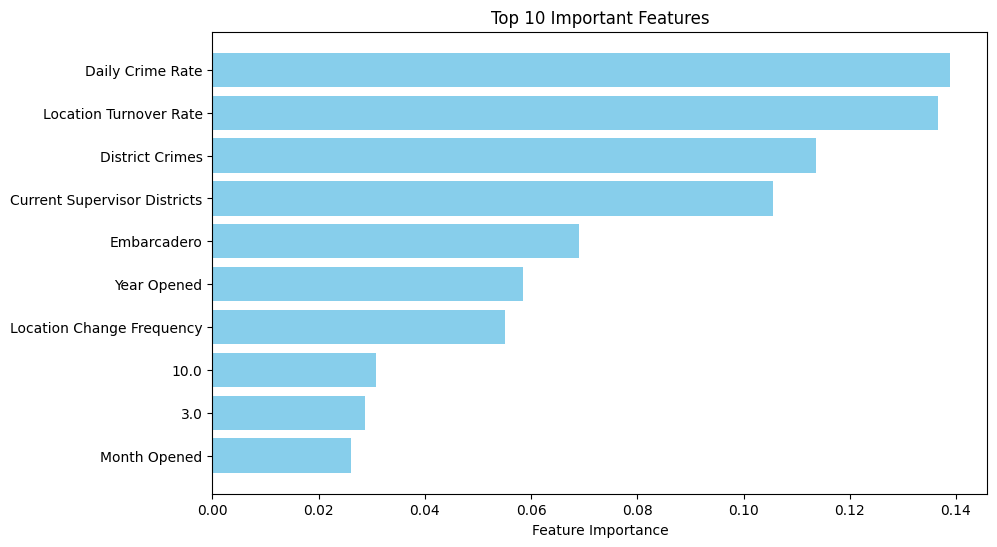

In [69]:
import matplotlib.pyplot as plt

# Get the feature importances from the trained Random Forest model
feature_importances = clf.feature_importances_

# Get the indices of the top 10 features
top_10_indices = np.argsort(feature_importances)[::-1][:10]

# Get the names of the top 10 features based on your dataset's column names
top_10_features = X_train_scaled.columns[top_10_indices]

# Get the corresponding feature importances for the top 10 features
top_10_importances = [feature_importances[i] for i in top_10_indices]

# Print the top 10 features and their importances
for feature, importance in zip(top_10_features, top_10_importances):
    print(f"Feature: {feature}, Importance: {importance:.4f}")

# Create a bar chart to visualize the top 10 features
plt.figure(figsize=(10, 6))
plt.barh(top_10_features, top_10_importances, color='skyblue')
plt.xlabel('Feature Importance')
plt.title('Top 10 Important Features')
plt.gca().invert_yaxis()  # Invert the y-axis for better visualization
plt.show()



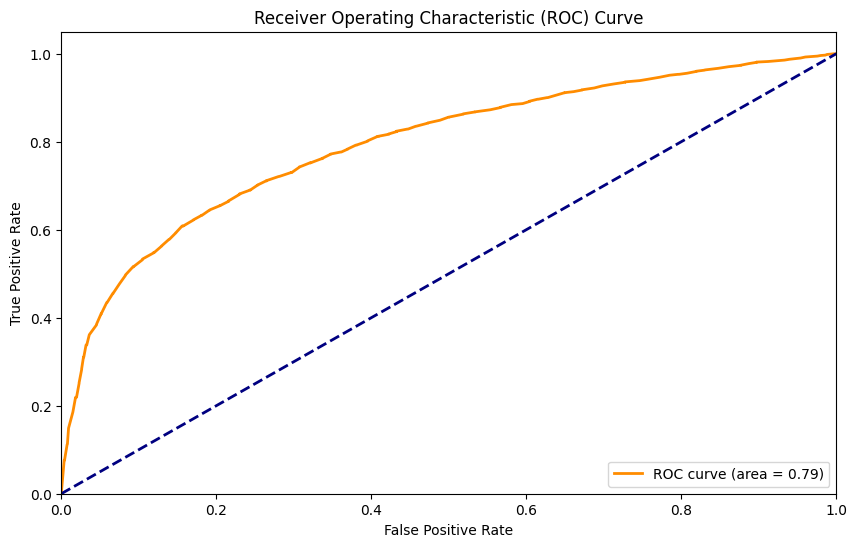

In [70]:

# Compute ROC curve and ROC-AUC for the positive class (class 1)
fpr, tpr, _ = roc_curve(y_test_encoded, probabilities[:, 1])
roc_auc = auc(fpr, tpr)

# Plot ROC curve
plt.figure(figsize=(10, 6))
plt.plot(fpr, tpr, color='darkorange', lw=2, label='ROC curve (area = %0.2f)' % roc_auc)
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC) Curve')
plt.legend(loc='lower right')
plt.show()


In [71]:
# Calculate F1 score for different thresholds
thresholds = np.linspace(0, 1, 100)
f1_scores = [f1_score(y_test_encoded, probabilities[:, 1] > t) for t in thresholds]

# Find the threshold that maximizes the F1 score
optimal_threshold = thresholds[np.argmax(f1_scores)]
max_f1_score = max(f1_scores)

print("Optimal Threshold:", optimal_threshold)
print("Max F1 Score:", max_f1_score)



Optimal Threshold: 0.38383838383838387
Max F1 Score: 0.8194854062849588


In [72]:
# Custom threshold classifier
y_pred_custom = (probabilities[:, 1] > optimal_threshold).astype(int)

accuracy = accuracy_score(y_test_encoded, y_pred_custom)
precision = precision_score(y_test_encoded, y_pred_custom)
recall = recall_score(y_test_encoded, y_pred_custom)
f1 = f1_score(y_test_encoded, y_pred_custom)

print("Custom Threshold Classifier Performance:")
print("Accuracy:", accuracy)
print("Precision:", precision)
print("Recall:", recall)
print("F1 Score:", f1)


Custom Threshold Classifier Performance:
Accuracy: 0.7290076335877863
Precision: 0.744319231479771
Recall: 0.9115384615384615
F1 Score: 0.8194854062849588


In [46]:
#Hypertune Random Forest

# Define a parameter grid to search
param_grid = {
    'n_estimators': [100, 200, 300],
    'max_depth': [None, 10, 20, 30],
    # Add other hyperparameters as needed
}

# Create a Random Forest Classifier
clf = RandomForestClassifier(random_state=42)

# Create a GridSearchCV object with F1 score as the scoring metric
grid_search = GridSearchCV(clf, param_grid, scoring='f1', cv=5, n_jobs=-1)

# Fit the grid search to your data
grid_search.fit(X_train_scaled, y_train_encoded)

# Get the best hyperparameters
best_params = grid_search.best_params_

print("Best Hyperparameters:", best_params)


Best Hyperparameters: {'max_depth': 10, 'n_estimators': 300}


Hypertuning Random forest above, Best Hyperparameters: {'max_depth': 10, 'n_estimators': 300}

In [73]:
# Create a XGBoostClassifier
xgb = XGBClassifier(random_state=42)
# Train the XGBoost model on your training data
xgb.fit(X_train_scaled, y_train_encoded)
# Make predictions on the testing data
y_pred_xgb = xgb.predict(X_test_scaled)
# Predict class probabilities on the test data
probabilities_xgb = xgb.predict_proba(X_test_scaled)
# Calculate ROC-AUC score for XGBoost
roc_auc_xgb = roc_auc_score(y_test_encoded, probabilities_xgb[:, 1])
# Calculate the F1 score for XGBoost
f1_xgb = f1_score(y_test_encoded, y_pred_xgb)

# Create a Logistic Regression classifier
lgr = LogisticRegression(random_state=42)
# Train the Logistic Regression model on your training data
lgr.fit(X_train_scaled, y_train_encoded)
# Make predictions on the testing data
y_pred_lgr = lgr.predict(X_test_scaled)
# Predict class probabilities on the test data
probabilities_lgr = lgr.predict_proba(X_test_scaled)
# Calculate ROC-AUC score for Logistic Regression
roc_auc_lgr = roc_auc_score(y_test_encoded, probabilities_lgr[:, 1])
# Calculate the F1 score for Logistic Regression
f1_lgr = f1_score(y_test_encoded, y_pred_lgr)

# Print the results for XGBoost
print("XGBoost ROC-AUC Score:", roc_auc_xgb)
print("XGBoost F1 Score:", f1_xgb)

# Print the results for Logistic Regression
print("Logistic Regression ROC-AUC Score:", roc_auc_lgr)
print("Logistic Regression F1 Score:", f1_lgr)


XGBoost ROC-AUC Score: 0.8624526798801861
XGBoost F1 Score: 0.83967602352158
Logistic Regression ROC-AUC Score: 0.7634760903277888
Logistic Regression F1 Score: 0.8093540268456376


### 5.4 Model Selection ###

In [49]:
#Choose XGBoost which seems to have better results.


# Define the parameter grid for hyperparameter tuning
param_grid = {
    'n_estimators': [100, 200, 300, 400, 500],
    'learning_rate': [0.01, 0.1, 0.2, 0.3],
    'max_depth': [3, 4, 5, 6, 7, 8, 9, 10],
    'min_child_weight': [1, 2, 3, 4],
    'gamma': [0, 0.1, 0.2, 0.3, 0.4],
    'subsample': [0.8, 0.9, 1.0],
    'colsample_bytree': [0.8, 0.9, 1.0],
}

# Create an instance of the XGBoost classifier
xgb = XGBClassifier()

# Create an instance of RandomizedSearchCV
random_search = RandomizedSearchCV(
    xgb,
    param_distributions=param_grid,
    n_iter=50,  # Adjust this value as needed
    scoring='f1',
    cv=5,  # Number of cross-validation folds
    verbose=2,
    random_state=42,
    n_jobs=-1  # Use all available CPU cores
)

# Fit the RandomizedSearchCV on your training data
random_search.fit(X_train_scaled, y_train_encoded)

# Print the best parameters and F1 score
print("Best Parameters: ", random_search.best_params_)
y_pred = random_search.predict(X_test_scaled)
f1 = f1_score(y_test_encoded, y_pred)
print("Best F1 Score: ", f1)


Fitting 5 folds for each of 50 candidates, totalling 250 fits
[CV] END colsample_bytree=0.9, gamma=0.3, learning_rate=0.01, max_depth=10, min_child_weight=2, n_estimators=100, subsample=0.8; total time=  11.9s
[CV] END colsample_bytree=0.9, gamma=0.3, learning_rate=0.01, max_depth=10, min_child_weight=2, n_estimators=100, subsample=0.8; total time=  11.9s
[CV] END colsample_bytree=0.9, gamma=0.3, learning_rate=0.01, max_depth=10, min_child_weight=2, n_estimators=100, subsample=0.8; total time=  11.9s
[CV] END colsample_bytree=0.9, gamma=0.3, learning_rate=0.01, max_depth=10, min_child_weight=2, n_estimators=100, subsample=0.8; total time=  12.0s
[CV] END colsample_bytree=0.9, gamma=0.3, learning_rate=0.01, max_depth=10, min_child_weight=2, n_estimators=100, subsample=0.8; total time=  12.0s
[CV] END colsample_bytree=0.8, gamma=0, learning_rate=0.1, max_depth=9, min_child_weight=2, n_estimators=200, subsample=1.0; total time=  18.4s
[CV] END colsample_bytree=0.8, gamma=0, learning_rate=

KeyboardInterrupt: 

XGBoost Best Parameters:  

{'subsample': 1.0, 'n_estimators': 200, 'min_child_weight': 1, 'max_depth': 5, 'learning_rate': 0.2, 'gamma': 0.1, 'colsample_bytree': 0.8}

Best F1 Score:  0.8414661073084566

### Final Model ###

In [74]:

best_params = {'subsample': 1.0, 'n_estimators': 200, 'min_child_weight': 1, 'max_depth': 5, 'learning_rate': 0.2, 'gamma': 0.1, 'colsample_bytree': 0.8}

xgb_classifier = XGBClassifier(
    subsample=best_params['subsample'],
    n_estimators=best_params['n_estimators'],
    min_child_weight=best_params['min_child_weight'],
    max_depth=best_params['max_depth'],
    learning_rate=best_params['learning_rate'],
    gamma=best_params['gamma'],
    colsample_bytree=best_params['colsample_bytree'],
    random_state=42
)

xgb_classifier.fit(X_train_scaled, y_train_encoded)
y_pred = xgb_classifier.predict(X_test_scaled)

f1 = f1_score(y_test_encoded, y_pred)

# Predict probabilities instead of binary predictions
y_pred_prob = xgb_classifier.predict_proba(X_test_scaled)[:, 1]

# Calculate the AUC-ROC score
auc_roc = roc_auc_score(y_test_encoded, y_pred_prob)

print(f"F1 Score: {f1:.2f}")
print(f"AUC-ROC Score: {auc_roc:.2f}")

F1 Score: 0.84
AUC-ROC Score: 0.86


In [75]:

# Initialize RandomUnderSampler
undersampler = RandomUnderSampler(random_state=42)

# Apply undersampling to balance the classes in the training data
X_train_resampled, y_train_resampled = undersampler.fit_resample(X_train_scaled, y_train_encoded)

# Initialize XGBoost classifier with specified parameters
params = {
    'subsample': 1.0,
    'n_estimators': 200,
    'min_child_weight': 1,
    'max_depth': 5,
    'learning_rate': 0.2,
    'gamma': 0.1,
    'colsample_bytree': 0.8,
    'objective': 'binary:logistic',  # For binary classification
    'random_state': 42
}
clf = xgb.XGBClassifier(**params)

# Fit the classifier on the resampled training data
clf.fit(X_train_resampled, y_train_resampled)

# Generate predictions on the test data
y_pred_prob = clf.predict_proba(X_test_scaled)[:, 1]

# Calculate F1 score
f1 = f1_score(y_test_encoded, (y_pred_prob > 0.5).astype(int))

# Calculate ROC AUC score
roc_auc = roc_auc_score(y_test_encoded, y_pred_prob)

# Print F1 Score and ROC AUC Score
print("F1 Score:", f1)
print("ROC AUC Score:", roc_auc)


F1 Score: 0.8053741838272226
ROC AUC Score: 0.8610982410298897


### 5.5 Model Evaluation ###

In [76]:


# Generate predictions on the test data
y_pred_prob = clf.predict_proba(X_test_scaled)[:, 1]

# Threshold for classification (adjust as needed)
threshold = 0.5

# Convert probabilities to binary predictions based on the threshold
y_pred = (y_pred_prob > threshold).astype(int)

# Generate the classification report
report = classification_report(y_test_encoded, y_pred)

# Print the classification report
print("Classification Report:")
print(report)


Classification Report:
              precision    recall  f1-score   support

           0       0.60      0.84      0.70      2130
           1       0.90      0.73      0.81      4420

    accuracy                           0.76      6550
   macro avg       0.75      0.78      0.75      6550
weighted avg       0.80      0.76      0.77      6550



In [85]:
# Calculate the ROC curve
fpr, tpr, thresholds = roc_curve(y_test_encoded, y_pred_prob)

# Create a ROC curve trace
roc_trace = go.Scatter(
    x=fpr,
    y=tpr,
    mode='lines',
    name='ROC Curve',
)

# Create the filled area plot
area_fig = px.area(
    x=fpr, y=tpr,
    title=f'ROC Curve (AUC={auc(fpr, tpr):.4f})',
    labels=dict(x='False Positive Rate', y='True Positive Rate'),
    width=700, height=500
)

# Add a dashed line
area_fig.add_shape(
    type='line',
    line=dict(dash='dash'),
    x0=0, x1=1, y0=0, y1=1
)

# Update axes settings
area_fig.update_yaxes(scaleanchor="x", scaleratio=1)
area_fig.update_xaxes(constrain='domain')

# Show the filled area plot
area_fig.show()


The ROC Curve (Receiver Operating Characteristic Curve) is a graphical representation of the performance of a binary classification model across different classification thresholds. 

Therefore an AUC of 0.8611 suggests that our model has good discriminatory power and is effective at distinguishing between the positive and negative classes, but there may still be room for improvement.  It means that our model is performing relatively well in distinguishing between the two classes. A higher AUC indicates a better model performance. 

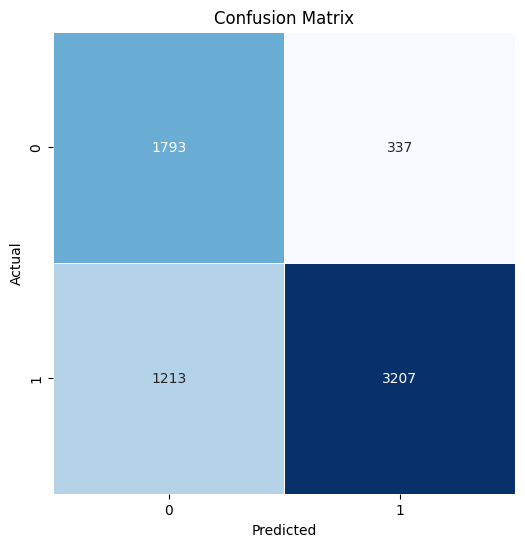

Confusion Matrix:
[[1793  337]
 [1213 3207]]


In [77]:
from sklearn.metrics import confusion_matrix
import seaborn as sns
import matplotlib.pyplot as plt

# Generate the confusion matrix
cm = confusion_matrix(y_test_encoded, y_pred)

# Create a heatmap of the confusion matrix
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', linewidths=.5, square=True, cbar=False)
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix')
plt.show()

# Print the confusion matrix
print("Confusion Matrix:")
print(cm)


The classification report provides a detailed evaluation of your model's performance on a binary classification task. 

Here's what each section of the classification report tells you about your model's performance:

1. **Precision**: Precision measures how many of the predicted positive instances were actually correct. In your case, for class 0, the precision is 0.60, which means that 60% of the instances predicted as class 0 were correct. For class 1, the precision is 0.91, indicating that 91% of the instances predicted as class 1 were correct.

2. **Recall**: Recall, also known as sensitivity or true positive rate, measures how many of the actual positive instances were correctly predicted. For class 0, the recall is 0.84, meaning that 84% of the actual class 0 instances were correctly predicted. For class 1, the recall is 0.73, indicating that 73% of the actual class 1 instances were correctly predicted.

3. **F1-Score**: The F1-score is the harmonic mean of precision and recall. It provides a balance between precision and recall. For class 0, the F1-score is 0.70, and for class 1, it's 0.81. A higher F1-score indicates a better balance between precision and recall.

4. **Support**: Support indicates the number of instances in each class in your dataset. In your case, you have 2130 instances of class 0 and 4420 instances of class 1.

5. **Accuracy**: Accuracy measures the overall correctness of your model's predictions. Your model has an accuracy of 0.76, meaning that it correctly predicted 76% of all instances.

6. **Macro Average**: The macro average is the unweighted average of precision, recall, and F1-score for both classes. In your case, the macro average precision is 0.75, macro average recall is 0.78, and macro average F1-score is 0.75.

7. **Weighted Average**: The weighted average is the average of precision, recall, and F1-score for both classes, weighted by the number of instances in each class. It accounts for class imbalances. In your case, the weighted average precision is 0.81, weighted average recall is 0.76, and weighted average F1-score is 0.77.

In summary, our model appears to have higher precision and recall for class 1, indicating it performs well in identifying class 1 instances. However, it has lower precision for class 0, although the recall is relatively good. The F1-scores, which balance precision and recall, are relatively good for both classes. The weighted average F1-score is 0.77, indicating a reasonably good overall model performance. Depending on a specific use case and class distribution, one may need to further tune the model to improve its performance.

In [78]:
import pickle

# Get feature importance scores
feature_importance = clf.feature_importances_

# Get the names of the features
feature_names = X_train_scaled.columns  # Assuming X_train_scaled is a DataFrame

# Create a DataFrame to store feature names and their importance scores
feature_importance_df = pd.DataFrame({'Feature': feature_names, 'Importance': feature_importance})

# Sort the features by importance in descending order
feature_importance_df = feature_importance_df.sort_values(by='Importance', ascending=False)

# Select the top 15 features
top_features = feature_importance_df.head(15)[::-1]


# # Assuming 'top_features' contains the top 15 features
# top_features = feature_importance_df.head(15)

# Define the path for the pickle file
pickle_file_path = 'top_features.pkl'

# Save the top features to a pickle file
with open(pickle_file_path, 'wb') as pickle_file:
    pickle.dump(top_features, pickle_file)


# Format importance values to two decimal places
top_features['Importance'] = top_features['Importance'].apply(lambda x: round(x, 2))


# Format importance values to three decimal places
top_features['Importance'] = top_features['Importance'].apply(lambda x: round(x, 3))

# Create an interactive bar chart using Plotly Express
fig = px.bar(
    top_features,
    x='Importance',
    y='Feature',
    orientation='h',
    text='Importance',
    title='Top 15 Features Selected by XGBoost'
)

fig.update_traces(marker_color='skyblue', textposition='outside')
fig.update_layout(xaxis_title='Feature Importance Score', 
                  yaxis_title='Features', 
                  width=900, 
                  height=500,
                  template='simple_white',  # Use the simple white template
                xaxis_showgrid=False,  # Remove vertical grid lines
                yaxis_showgrid=False,  # Remove horizontal grid lines
)
                  
                  
fig.show()

In [79]:
top_features

,Feature,Importance
13,7.0,0.02
15,9.0,0.02
6,Location Turnover Rate,0.03
11,5.0,0.03
16,10.0,0.03
10,4.0,0.03
9,3.0,0.03
8,2.0,0.04
17,11.0,0.04
7,1.0,0.04


In [60]:
# Get the top feature names from the 'top_features' DataFrame
top_feature_names = top_features['Feature'].tolist()

# Print the top feature names as a list
print(top_feature_names)

['Location Turnover Rate', '7.0', '5.0', '4.0', '11.0', '8.0', '10.0', '2.0', '3.0', '1.0', 'Embarcadero', 'Current Supervisor Districts', 'Location Change Frequency', 'Year Opened', 'Transient Occupancy Tax']


The top 10 features selected by the XGBoost model provide valuable insights into the factors that are most influential in predicting business closures. The importance scores assigned to each feature indicate their relative significance in the model's decision-making process. 

Let's analyze the top features and what they tell us about the factors affecting business closures the most:

1. **Year Opened (0.20)**: The most critical feature, with the highest importance score, is "Year Opened." This suggests that the year a business opened plays a significant role in predicting closures. Newer businesses might be more susceptible to closures due to various reasons, such as initial challenges or changing market conditions.

2. **Transient Occupancy Tax (0.22)**: Transient Occupancy Tax is the second most crucial feature. This tax, which applies to short-term lodging, could reflect the impact of tourism and hospitality on business closures. A higher tax burden might discourage travelers, affecting businesses.

3. **Location Change Frequency (0.06)**: The frequency of location changes by businesses has notable importance. This indicates that businesses moving frequently are more likely to face closures. Frequent relocations might disrupt customer loyalty and stability.

4. **Current Supervisor Districts (0.06)**: The district where a business operates is also a significant factor in closures. Different districts may have varying economic conditions and regulations that influence business survival.

5. **Embarcadero (0.04)**: This BART Train Station, "Embarcadero," has a relatively high importance score. It suggests that train traffic at this station has unique characteristics or challenges that affect business closures.

6. **Other Districts (0.04)**: Districts 1 to 11 also demonstrate notable importance. Different districts may have distinct economic dynamics and regulatory environments, impacting closures differently.

7. **Location Turnover Rate (0.03)**: The turnover rate for business locations is a significant predictor of closures. High location turnover might be a sign of instability or market challenges.

8. **NAICS Code (0.03)**: Several NAICS (North American Industry Classification System) codes have similar importance scores. These codes classify industries, and certain industries may be more prone to closures due to various industry-specific factors.

Overall, these top features indicate that the year a business opened, its location (district and turnover rate), tax burdens, and industry classification are critical factors affecting business closures. These insights can guide policymakers and business owners in addressing the challenges associated with business closures and developing strategies for more sustainable operations.

In [56]:
#save my model



# ... (Your code for training the XGBoost model)

# Specify the file path where you want to save the model
model_filename = 'xgboost_model.pkl'

# Save the trained model to a pickle file
with open(model_filename, 'wb') as model_file:
    pickle.dump(clf, model_file)

print("Model saved as", model_filename)


Model saved as xgboost_model.pkl


In [80]:
#!pip install streamlit

In [81]:
# import streamlit as st
# import pickle
# import pandas as pd
# import xgboost as xgb

# # Load your preprocessed data, XGBoost model, and feature names
# X_train_scaled = pd.read_csv(
#     "X_train_scaled.csv"
# )  # Replace with your preprocessed X_train data
# X_test_scaled = pd.read_csv(
#     "X_test_scaled.csv"
# )  # Replace with your preprocessed X_test data
# y_train_encoded = pd.read_csv(
#     "y_train_encoded.csv"
# )  # Replace with your preprocessed y_train data
# model = pickle.load(open("xgboost_model.pkl", "rb"))
# feature_names = (
#     X_train_scaled.columns.tolist()
# )  # Assuming feature names are column names

# # Define your top features
# top_features = [
#     "Location Turnover Rate",
#     "7.0",
#     "5.0",
#     "4.0",
#     "11.0",
#     "8.0",
#     "10.0",
#     "2.0",
#     "3.0",
#     "1.0",
#     "Embarcadero",
#     "Current Supervisor Districts",
#     "Location Change Frequency",
#     "Year Opened",
#     "Transient Occupancy Tax",
# ]

# # Create a Streamlit web app
# st.title("XGBoost Classification Model")

# # Create input widgets for your top features
# input_features = {}
# st.header("Input Features")
# for feature in top_features:
#     input_features[feature] = st.number_input(f"Enter {feature}", step=0.01)

# # Make predictions
# if st.button("Predict"):
#     input_data = [input_features[feature] for feature in top_features]
#     input_df = pd.DataFrame([input_data], columns=top_features)

#     # Ensure user input is in the same format as your preprocessed data
#     user_input = input_df.values

#     # Make predictions with the model
#     prediction = model.predict(user_input)
#     st.write(f"Prediction: {prediction[0]}")

# # Display model information
# st.header("Model Information")
# st.write("XGBoost Classification Model")
# st.write("Top Features: ", top_features)

# # You can add more information about your model if needed

# 6. Results and Discussion # 

The model produced the following results:

***F1 Score: 0.8054***

***ROC AUC Score: 0.8611***

These results suggest that the XGBoost model is effective in classifying business closures. The F1 Score and ROC AUC Score reflect a strong model performance.

The Classification Report provides further insights, including precision, recall, and F1-Score for each class. In our specific case, the report indicates that classifying business closures is more accurate (higher F1-Score) than non-closures, which is valuable for our prediction task.

In summary, our machine learning approach using XGBoost, SMOTE, and a comprehensive feature selection process has yielded promising results in predicting business closures in San Francisco, CA. This analysis can be a valuable resource for policymakers and business owners looking to understand and address the challenges of business closures in the area. Further model tuning and feature engineering could enhance the predictive capabilities.

# 7. Conclusion #

The machine learning approach applied in this analysis demonstrates the potential to predict business closures effectively. By leveraging diverse data sources and robust techniques, we can gain valuable insights into factors contributing to business closures and, in turn, support local businesses and economic growth.